In [ ]:
!pip install opencv-python

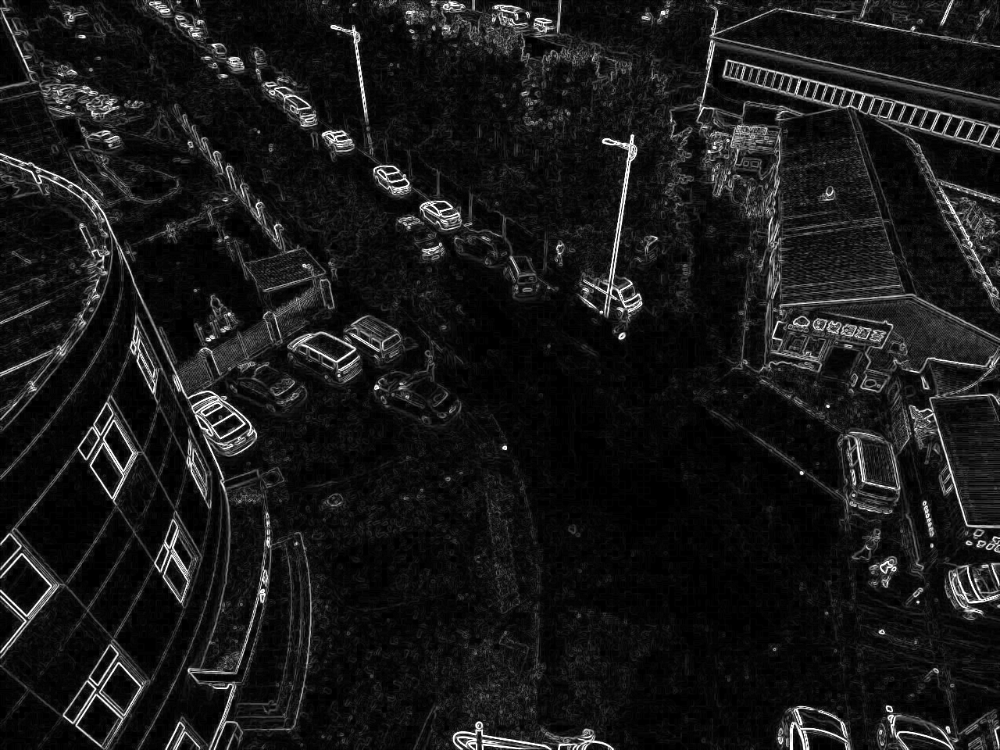

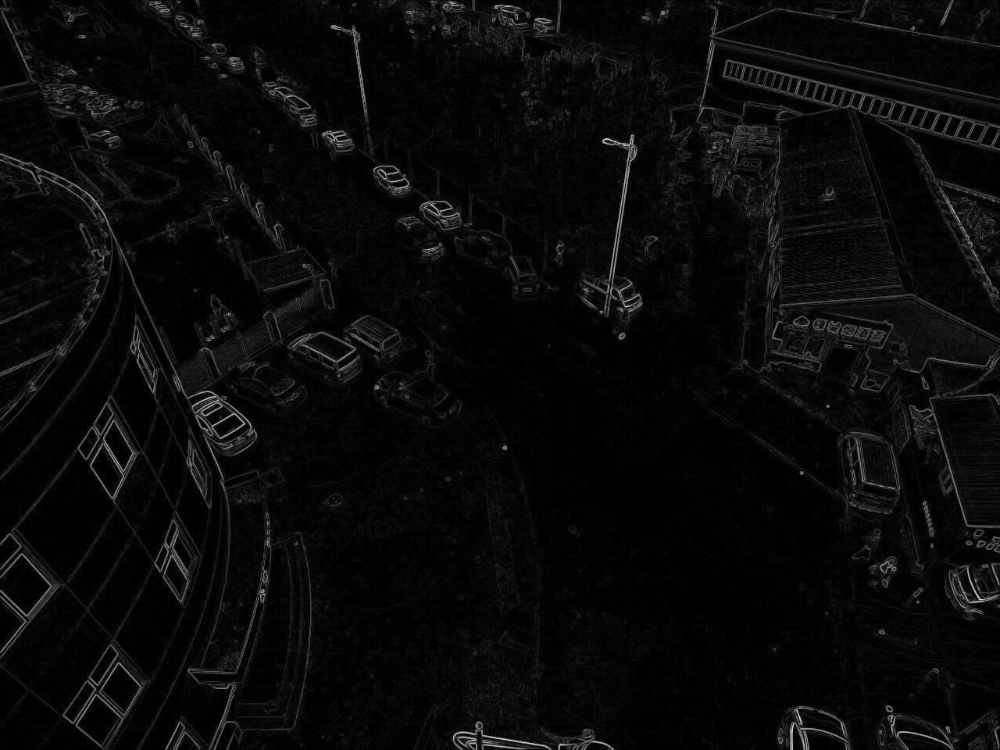

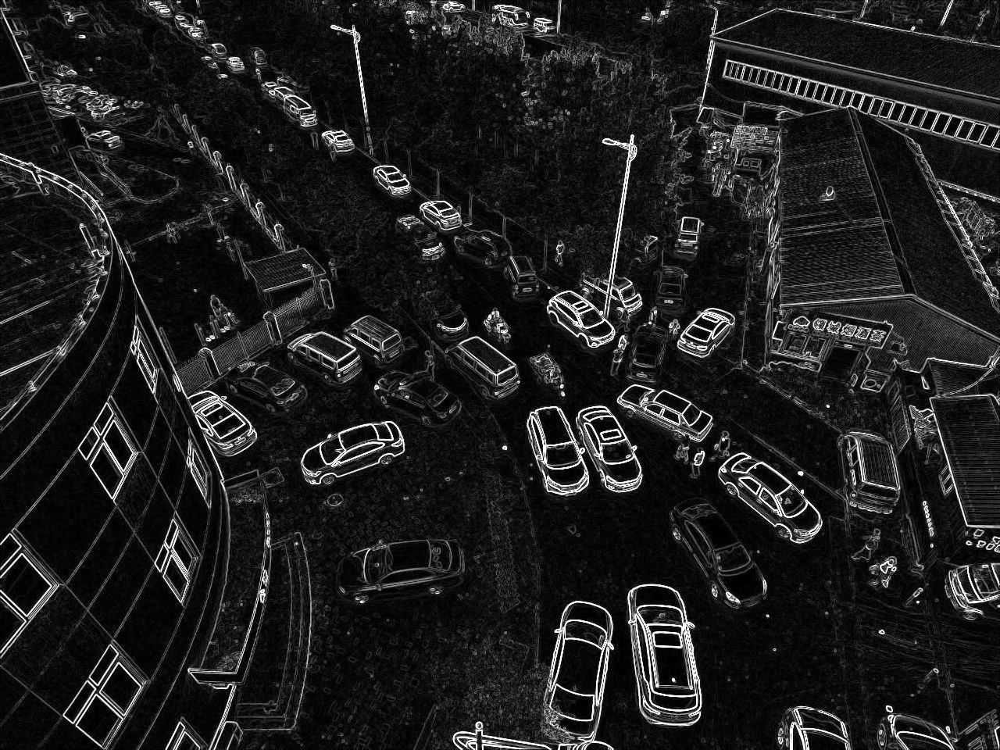

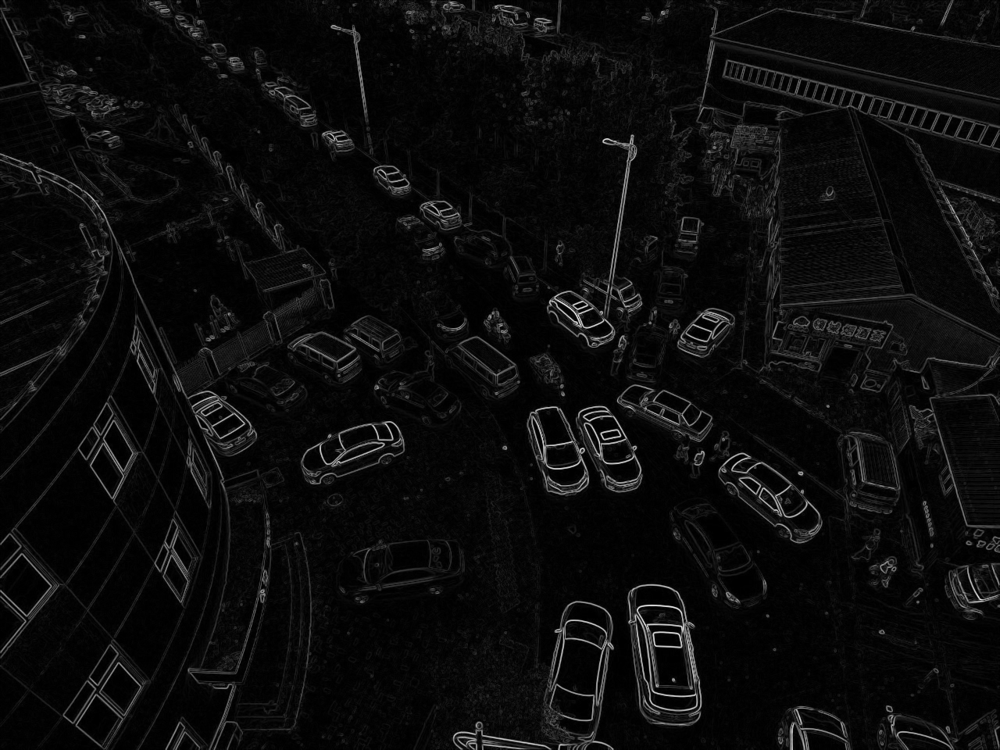

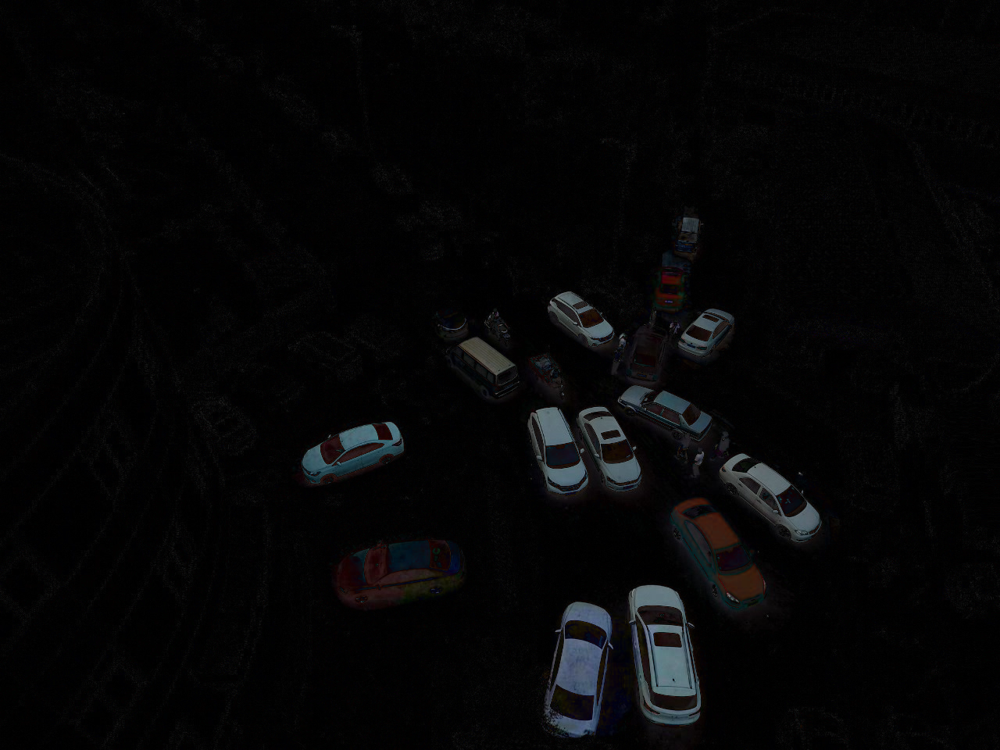

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow for displaying images in Colab

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def process_frame(self, frame):
        self.update_background_model(frame)
        self.update_foreground_model(frame)

        fgmask = self.foreground_model.apply(frame)
        fgmask = cv2.medianBlur(fgmask, 5)

        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask]*3)

        out = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)

        return out

target_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.39.58 AM.jpeg")
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.37.55 AM.jpeg")

fusion_image = FusionImage()

raw_gradient_target = fusion_image.calculate_raw_gradient(target_image)
normalized_gradient_target = fusion_image.calculate_normalized_gradient(raw_gradient_target)
raw_gradient_reference = fusion_image.calculate_raw_gradient(reference_image)
normalized_gradient_reference = fusion_image.calculate_normalized_gradient(raw_gradient_reference)

cv2_imshow(raw_gradient_target)
cv2_imshow(normalized_gradient_target)
cv2_imshow(raw_gradient_reference)
cv2_imshow(normalized_gradient_reference)
result_image = fusion_image.remove_reference_image(target_image, reference_image)

cv2_imshow(result_image)


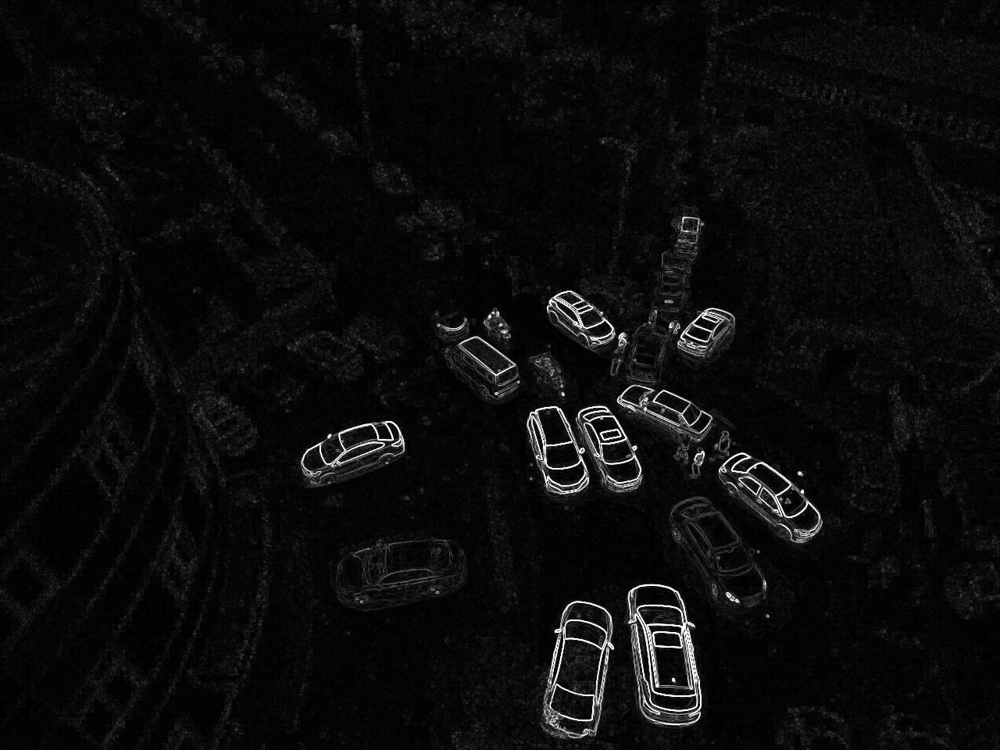

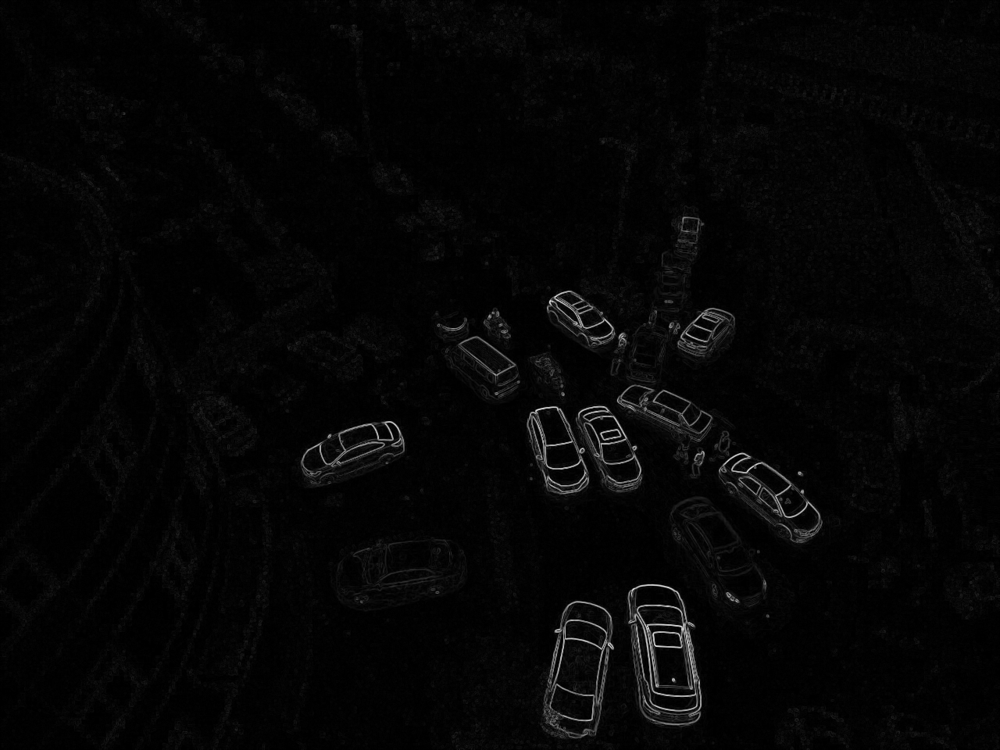

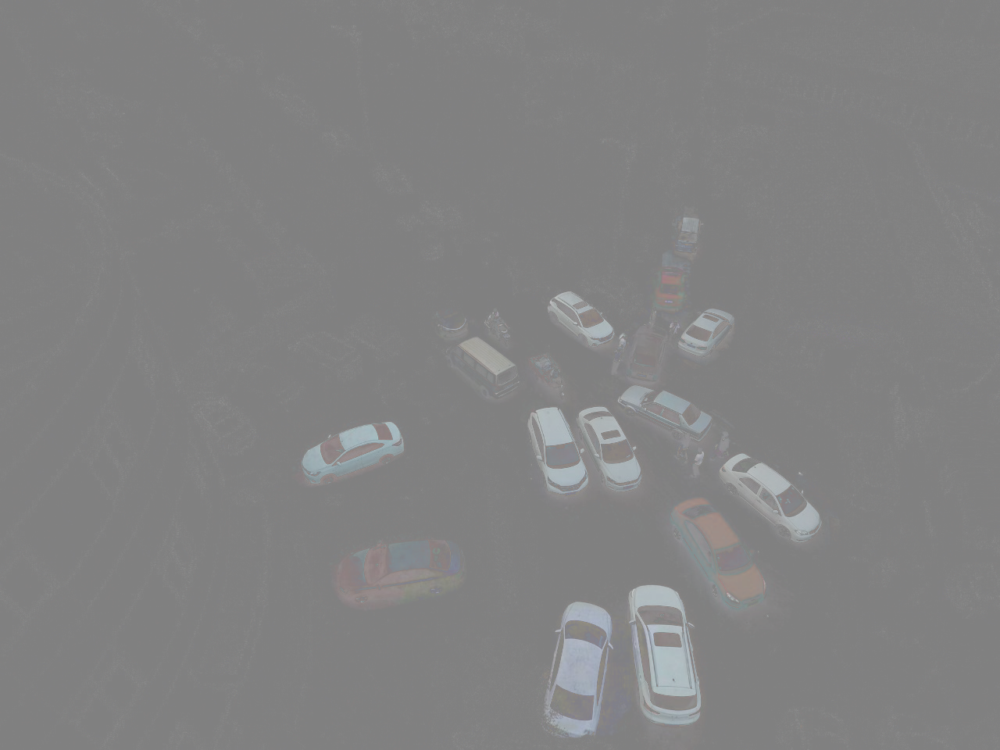

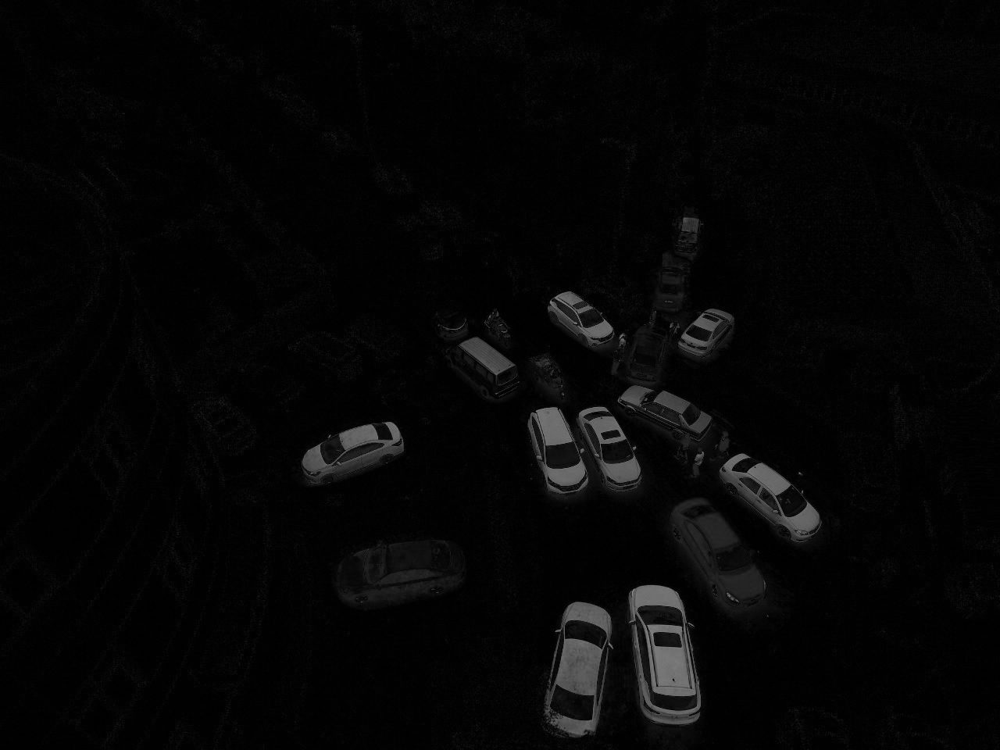

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow for displaying images in Colab

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def perform_aipf(self, frame):
        aipf_result = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        return aipf_result

    def process_frame(self, target_frame, reference_frame):
        fused_image = self.remove_reference_image(target_frame, reference_frame)

        self.update_background_model(fused_image)
        self.update_foreground_model(fused_image)

        fgmask = self.foreground_model.apply(fused_image)
        fgmask = cv2.medianBlur(fgmask, 5)

        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask]*3)

        raw_gradient_result = self.calculate_raw_gradient(fused_image)

        normalized_gradient_result = self.calculate_normalized_gradient(raw_gradient_result)

        aipf_result = self.perform_aipf(fused_image)

        fusion_image = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)

        return raw_gradient_result, normalized_gradient_result, fusion_image, aipf_result

target_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.39.58 AM.jpeg")
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.37.55 AM.jpeg")


fusion_image = FusionImage()

raw_gradient_result, normalized_gradient_result, fusion_result, aipf_result = fusion_image.process_frame(target_image, reference_image)
cv2_imshow(raw_gradient_result)
cv2_imshow(normalized_gradient_result)
cv2_imshow(fusion_result)
cv2_imshow(aipf_result)


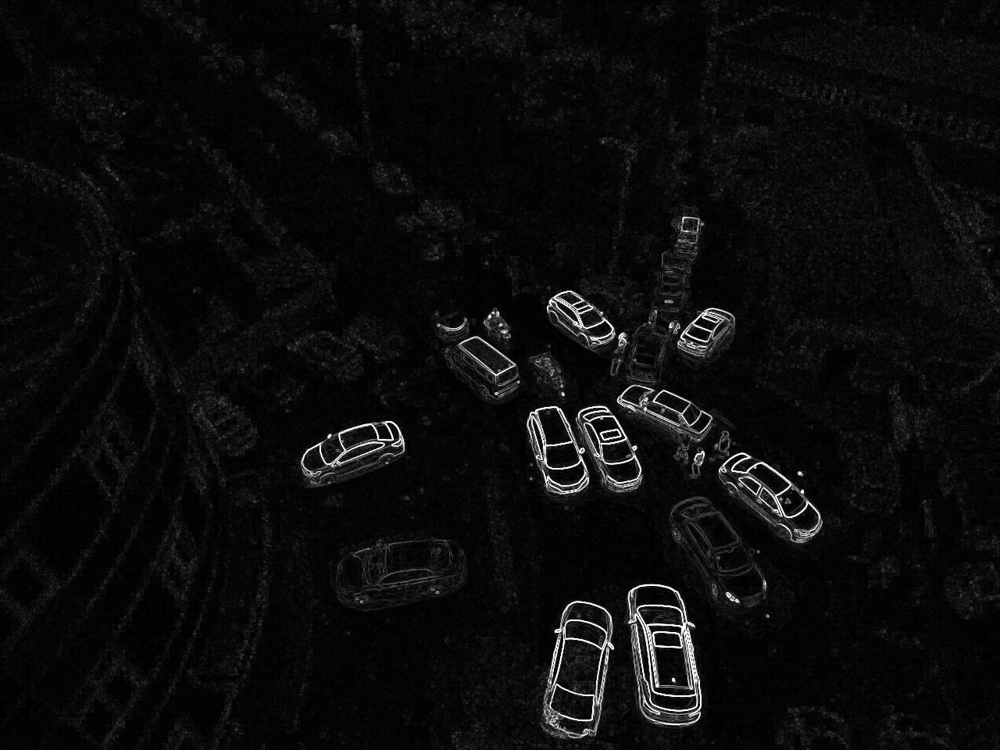

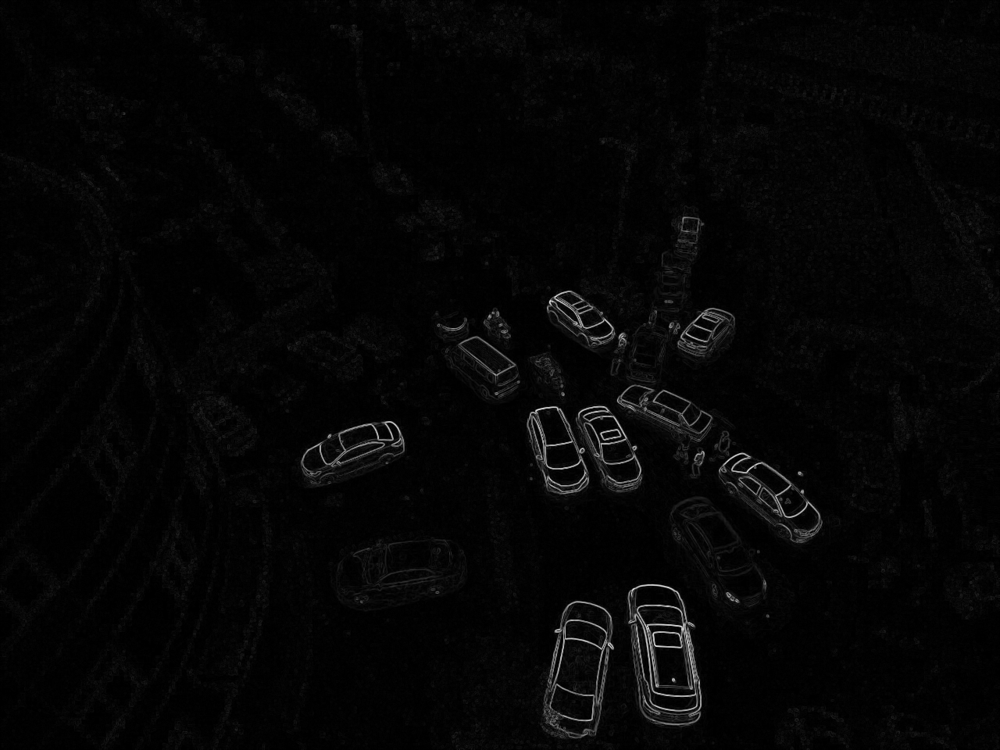

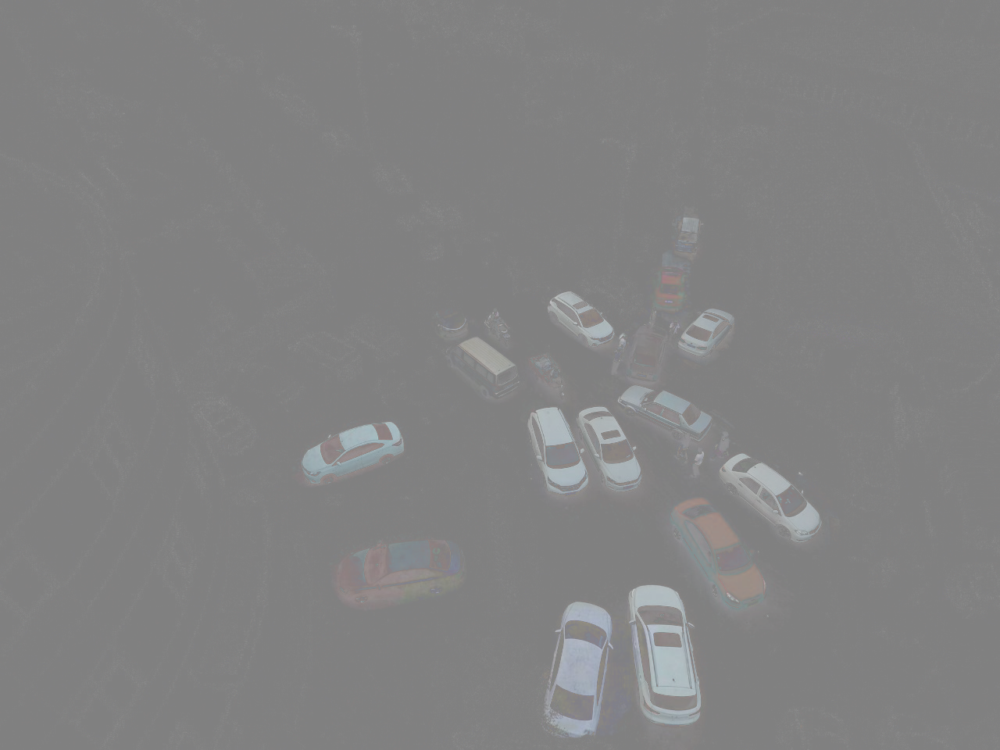

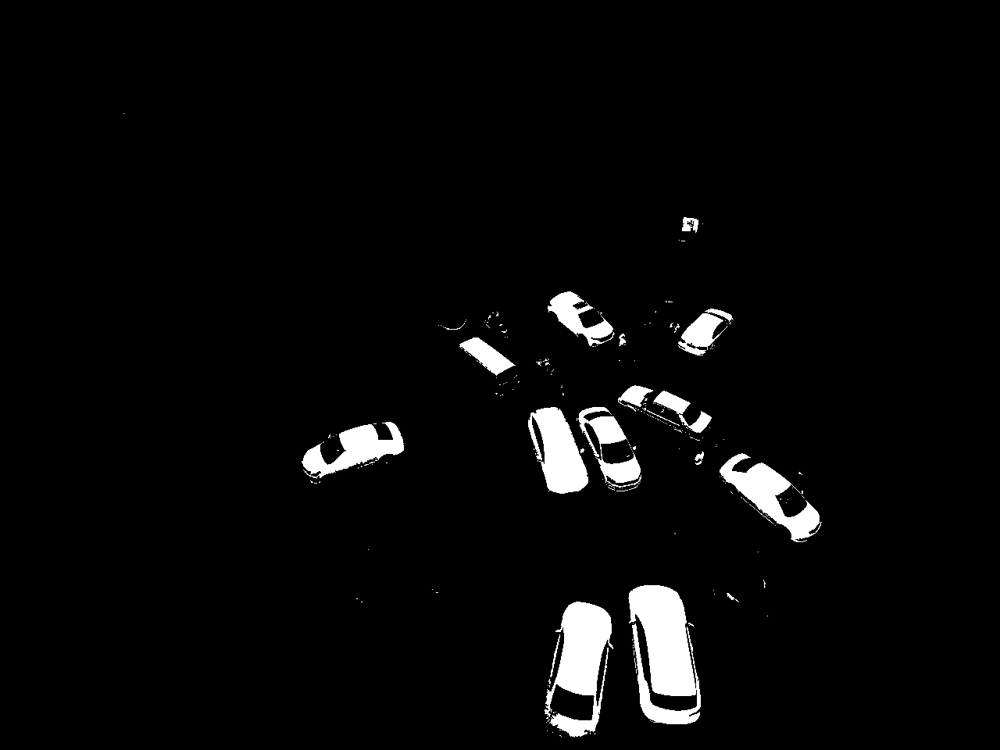

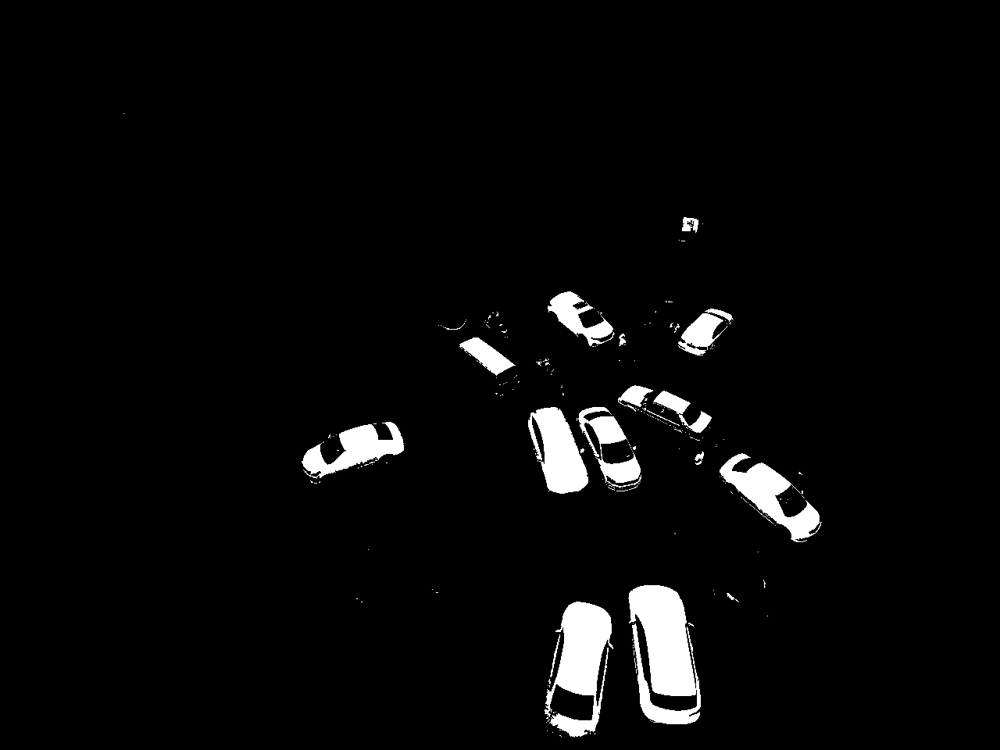

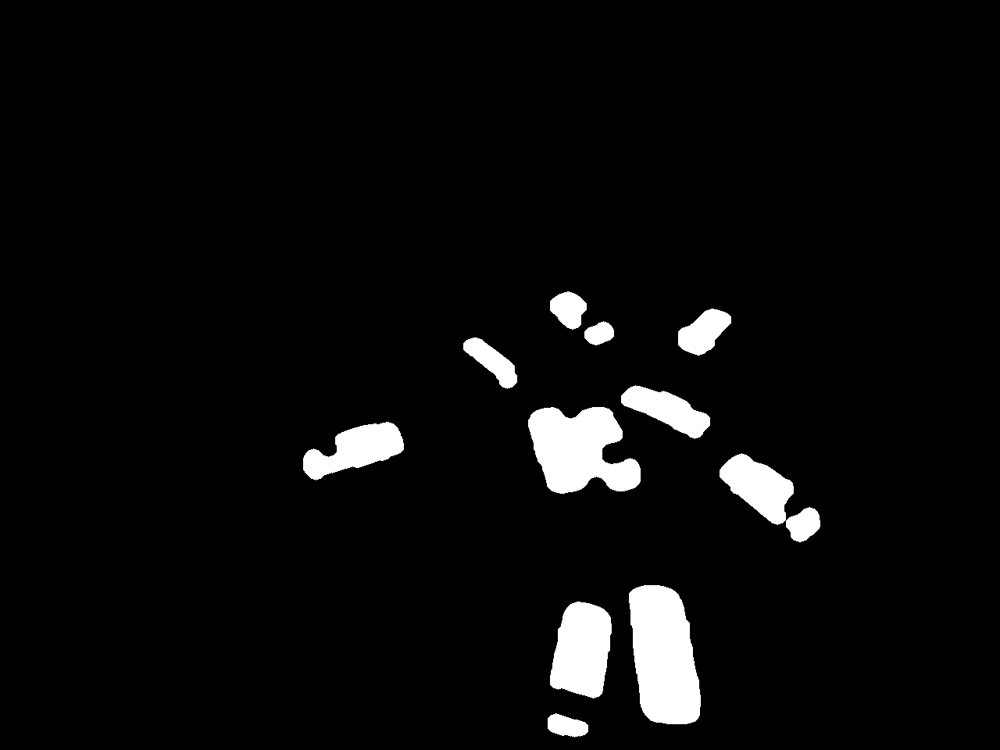

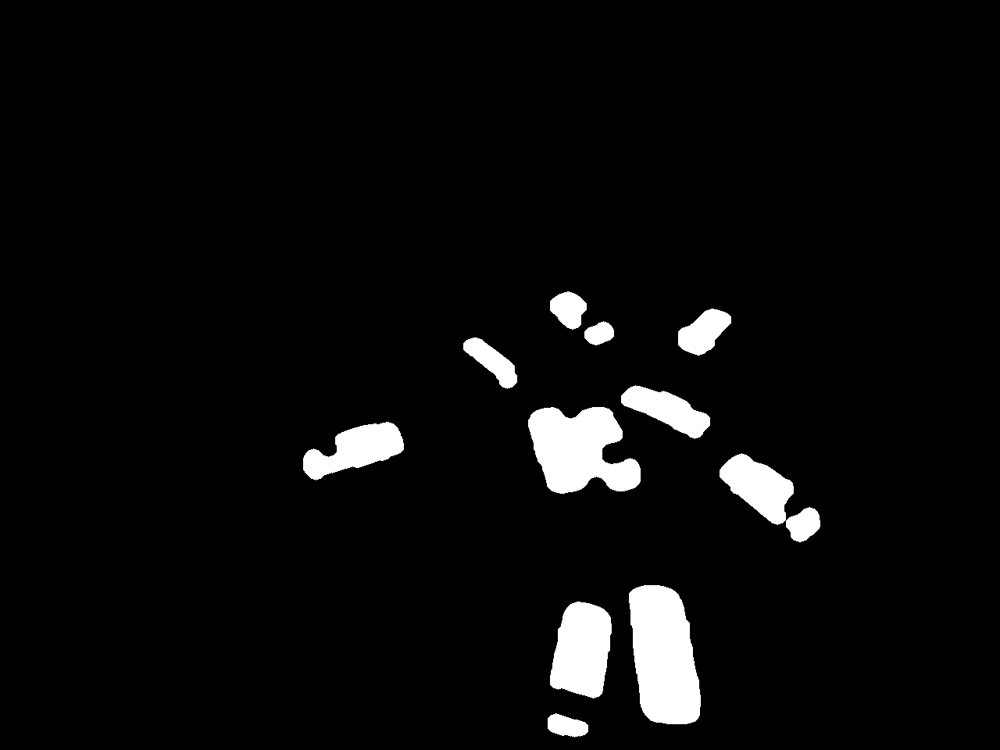

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def perform_aipf(self, frame):
        if len(frame.shape) == 3 and frame.shape[2] == 3:
            aipf_result = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        else:
            aipf_result = frame
        return aipf_result

    def process_frame(self, target_frame, reference_frame):
        fused_image = self.remove_reference_image(target_frame, reference_frame)

        self.update_background_model(fused_image)
        self.update_foreground_model(fused_image)

        fgmask = self.foreground_model.apply(fused_image)
        fgmask = cv2.medianBlur(fgmask, 5)

        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask]*3)

        raw_gradient_result = self.calculate_raw_gradient(fused_image)

        normalized_gradient_result = self.calculate_normalized_gradient(raw_gradient_result)

        fusion_image = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)

        _, otsu_result = cv2.threshold(cv2.cvtColor(fusion_image, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        hole_filled_result = self.fill_holes(otsu_result)

        morphological_result = self.adaptive_morphology(hole_filled_result)

        aipf_result = self.perform_aipf(morphological_result)

        return raw_gradient_result, normalized_gradient_result, fusion_image, otsu_result, hole_filled_result, morphological_result, aipf_result


    def fill_holes(self, binary_image):
        contours, hierarchy = cv2.findContours(binary_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        for i in range(len(contours)):
            cv2.drawContours(binary_image, contours, i, 255, thickness=cv2.FILLED, lineType=cv2.LINE_8, hierarchy=hierarchy, maxLevel=0)

        return binary_image


    def adaptive_morphology(self, binary_image):
        kernel_size = 5
        adaptive_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2 * kernel_size + 1, 2 * kernel_size + 1))
        morphological_result = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, adaptive_kernel, iterations=2)
        morphological_result = cv2.morphologyEx(morphological_result, cv2.MORPH_OPEN, adaptive_kernel, iterations=2)

        return morphological_result

target_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.39.58 AM.jpeg")
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 1.37.55 AM.jpeg")

fusion_image = FusionImage()

raw_gradient_result, normalized_gradient_result, fusion_result, otsu_result, hole_filled_result, morphological_result, aipf_result = fusion_image.process_frame(target_image, reference_image)

cv2_imshow(raw_gradient_result)
cv2_imshow(normalized_gradient_result)
cv2_imshow(fusion_result)
cv2_imshow(otsu_result)
cv2_imshow(hole_filled_result)
cv2_imshow(morphological_result)
cv2_imshow(aipf_result)


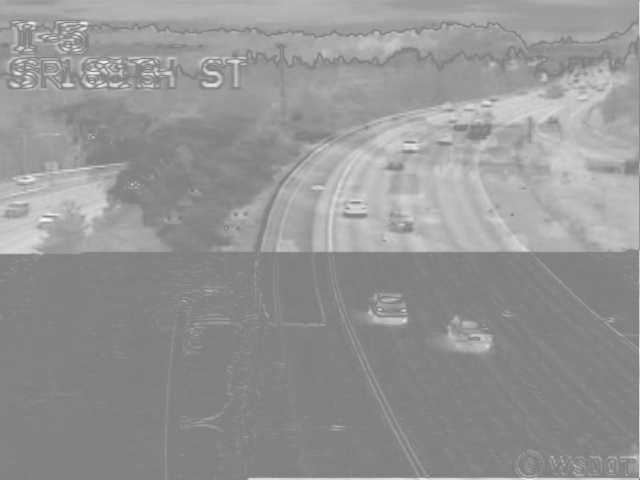

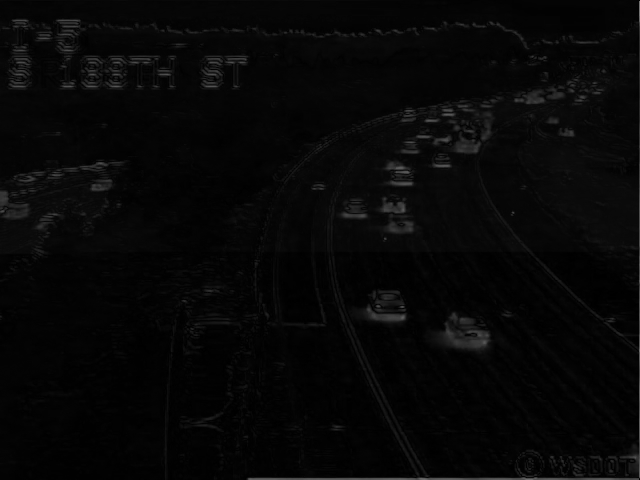

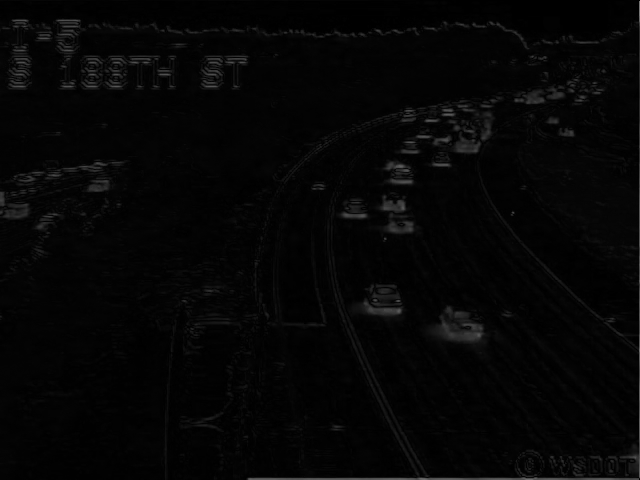

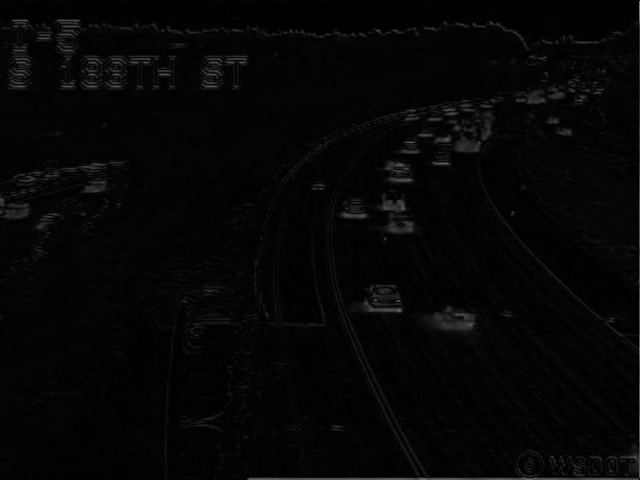

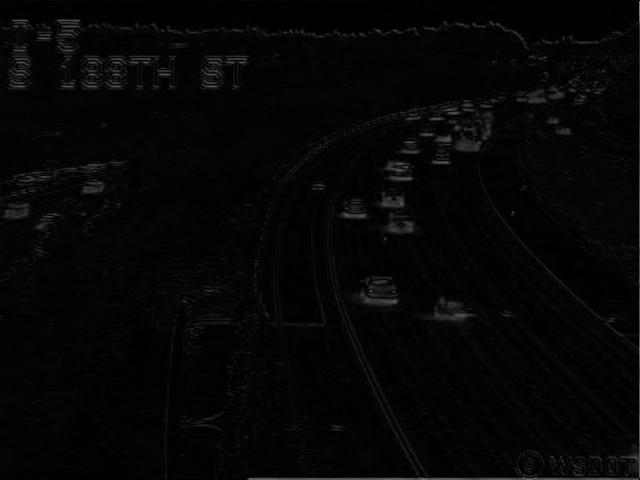

...

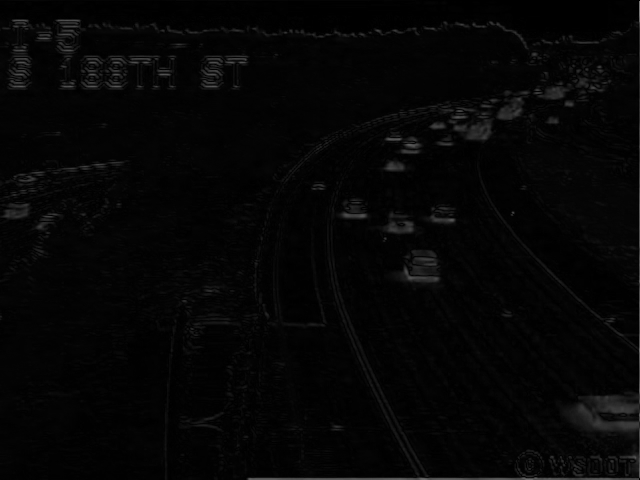

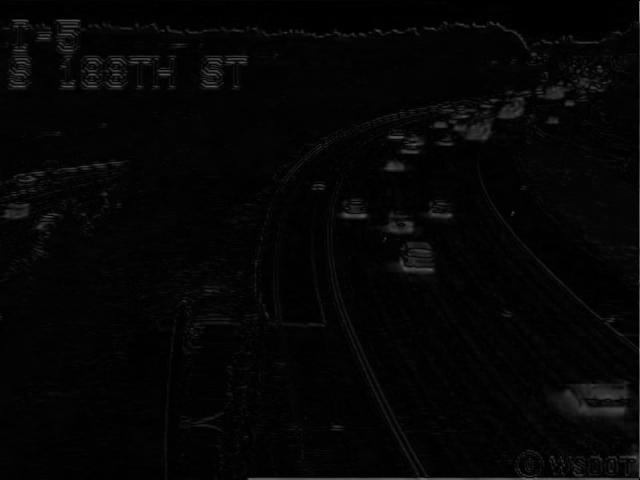

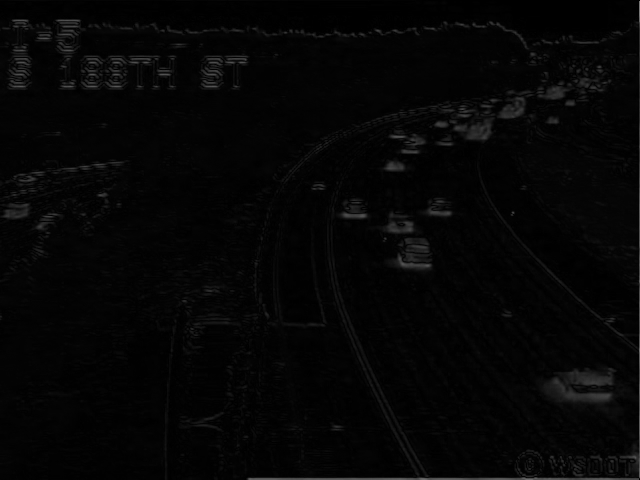

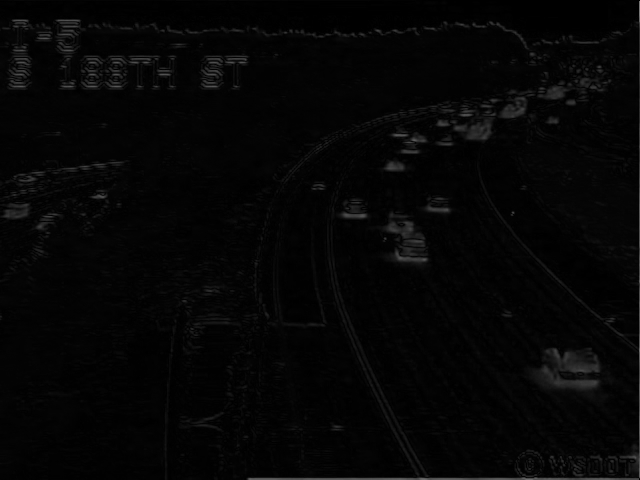

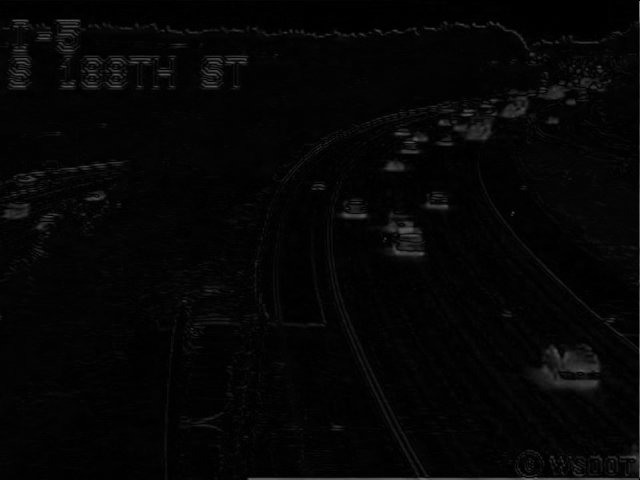

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow # Import cv2_imshow for displaying images in Colab

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        if len(reference_frame.shape) == 2:
            reference_frame = cv2.cvtColor(reference_frame, cv2.COLOR_GRAY2BGR)
        if len(target_frame.shape) == 2:
            target_frame = cv2.cvtColor(target_frame, cv2.COLOR_GRAY2BGR)
        if target_frame.shape[:2] != reference_frame.shape[:2] or target_frame.shape[2] != reference_frame.shape[2]:
            reference_frame = cv2.resize(reference_frame, (target_frame.shape[1], target_frame.shape[0]))
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def perform_aipf(self, frame):
        aipf_result = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        return aipf_result

    def process_frame(self, target_frame, reference_frame):
        fused_image = self.remove_reference_image(target_frame, reference_frame)
        self.update_background_model(fused_image)
        self.update_foreground_model(fused_image)
        fgmask = self.foreground_model.apply(fused_image)
        fgmask = cv2.medianBlur(fgmask, 5)
        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask]*3)
        fusion_image = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)
        aipf_result = self.perform_aipf(fusion_image)
        return aipf_result

video_path = "/content/WhatsApp Video 2024-03-11 at 2.49.06 AM.mp4" # Replace with your video file path
cap = cv2.VideoCapture(video_path)


fusion_image = FusionImage()
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 3.19.37 AM.jpeg")
frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    if frame_count % 3 == 0:
        if len(frame.shape) == 3 and frame.shape[2] == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        aipf_result = fusion_image.process_frame(frame, reference_image)
        cv2_imshow(aipf_result)
    frame_count += 1

cap.release()
cv2.destroyAllWindows()


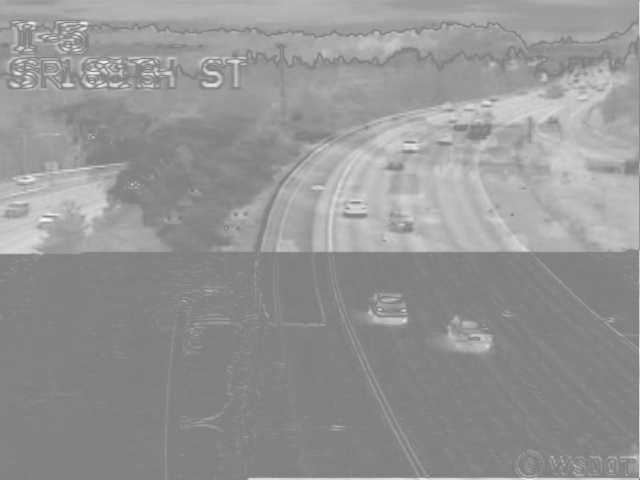

Vehicle Count: 0


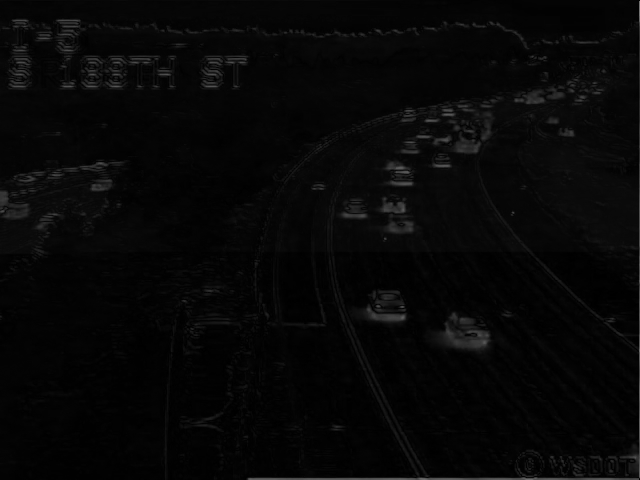

Vehicle Count: 0


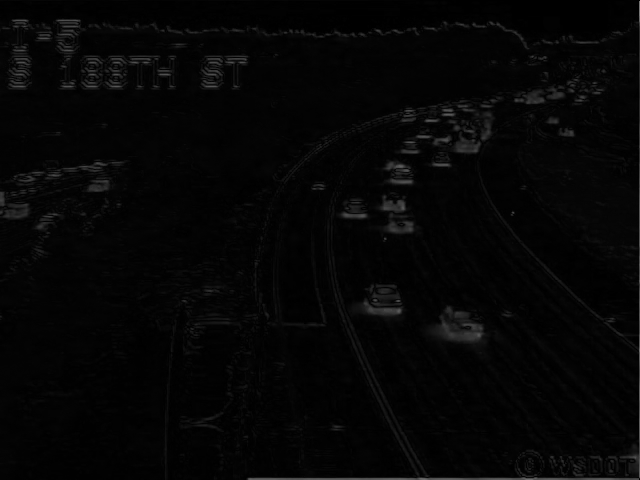

Vehicle Count: 0


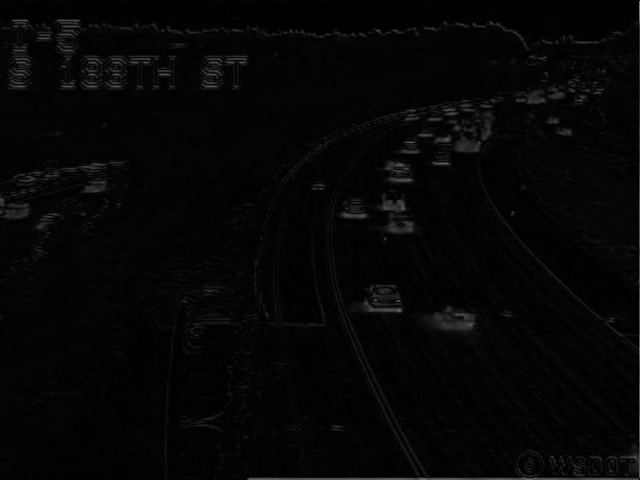

Vehicle Count: 0


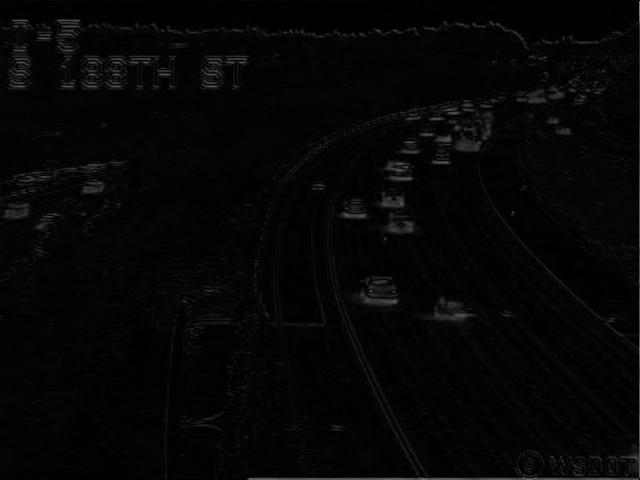

Vehicle Count: 0


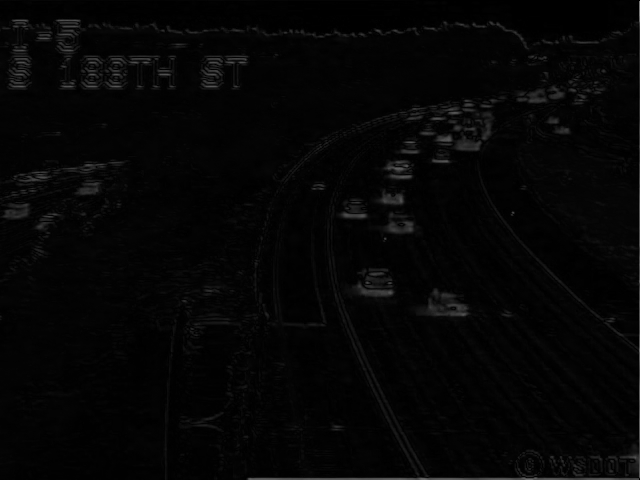

Vehicle Count: 0


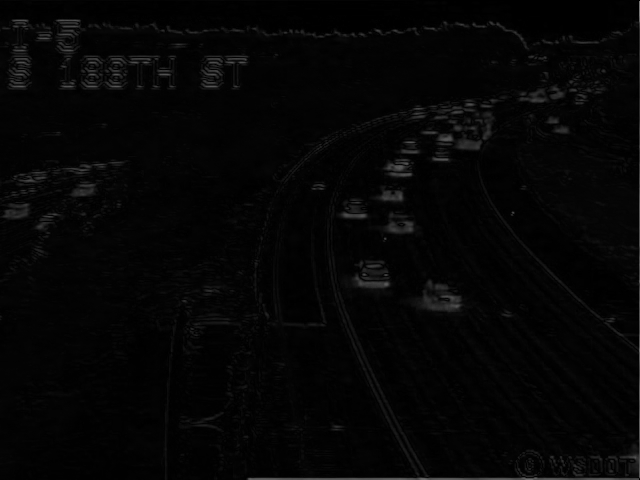

Vehicle Count: 0


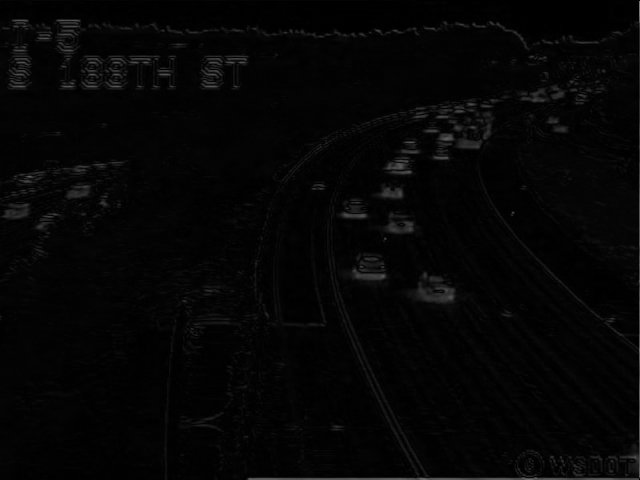

Vehicle Count: 0


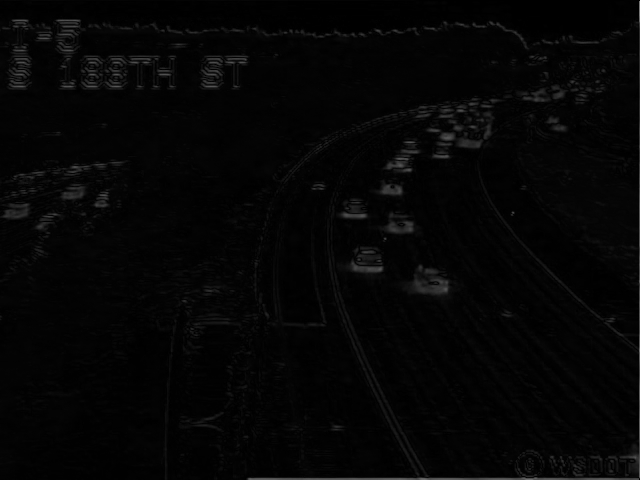

Vehicle Count: 0


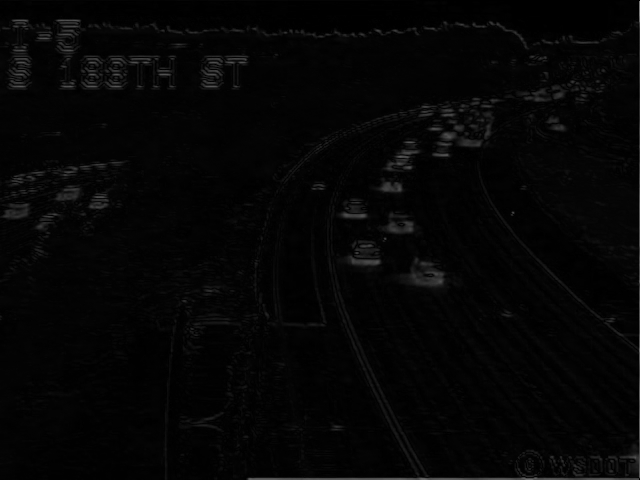

Vehicle Count: 0


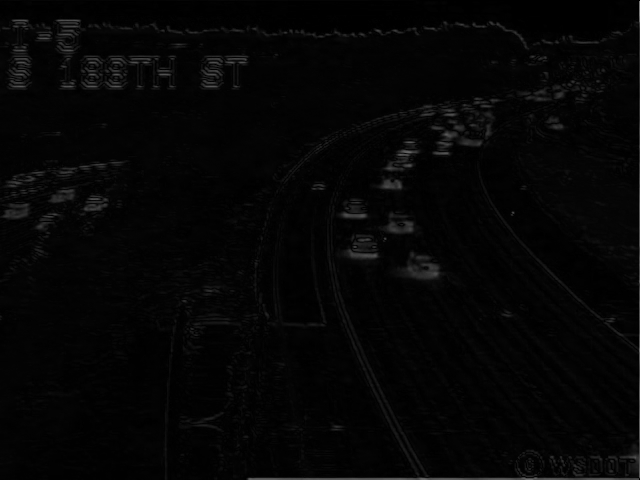

Vehicle Count: 0


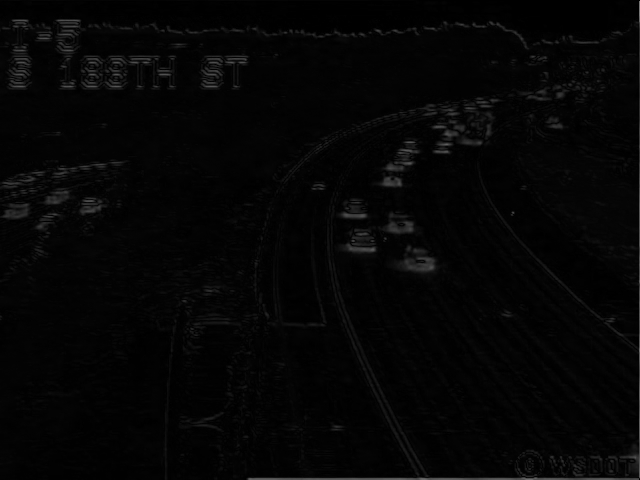

Vehicle Count: 0


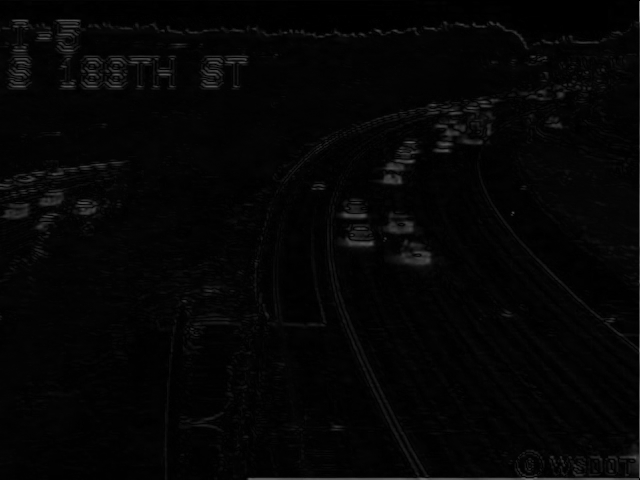

Vehicle Count: 0


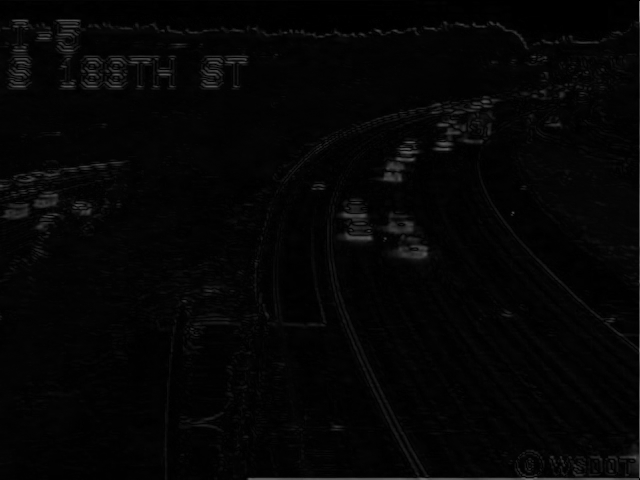

Vehicle Count: 0


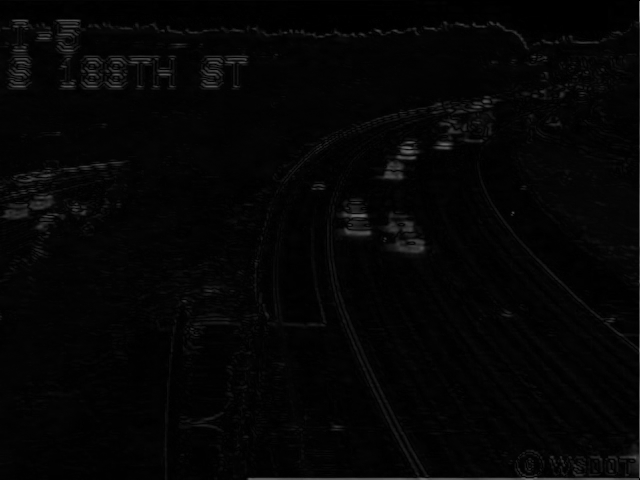

Vehicle Count: 0


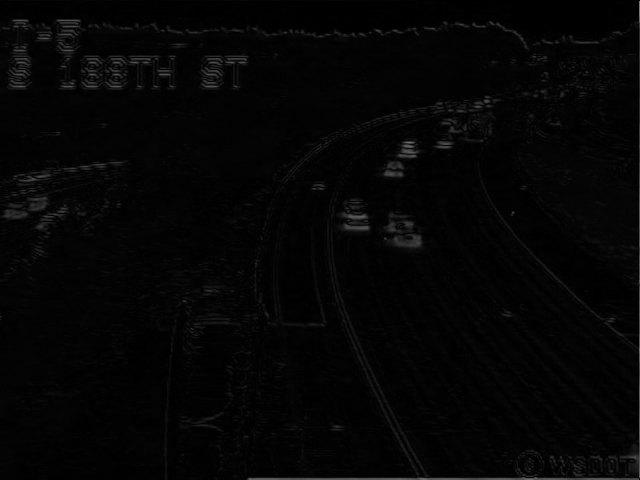

Vehicle Count: 0


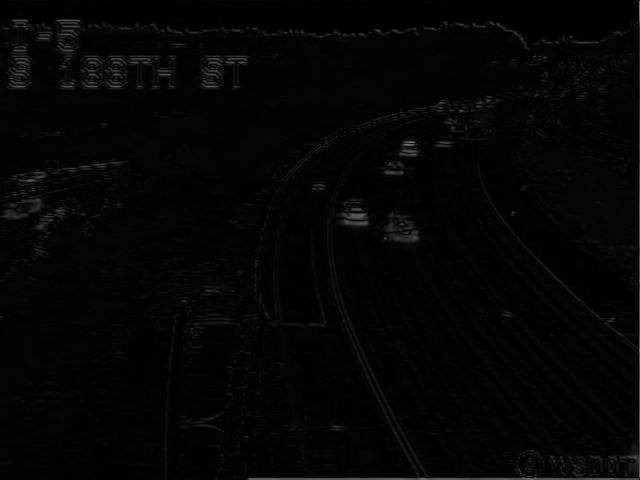

Vehicle Count: 0


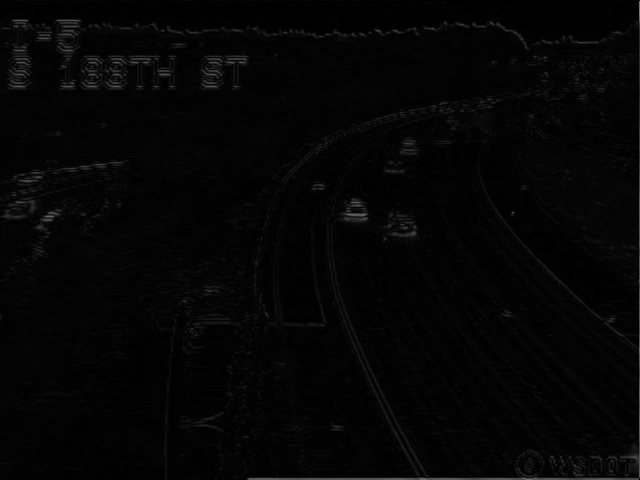

Vehicle Count: 0


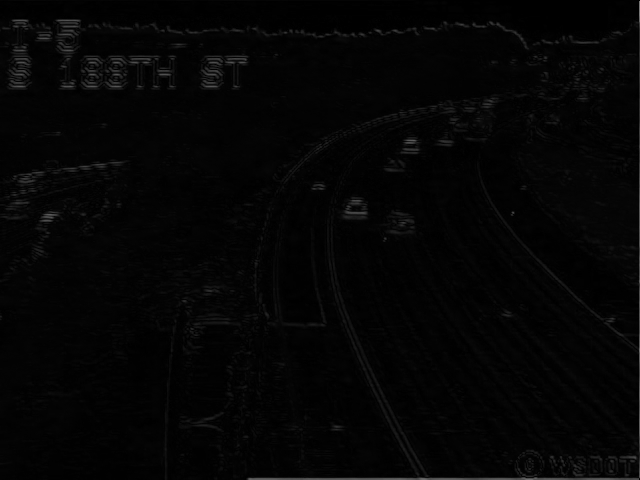

Vehicle Count: 0


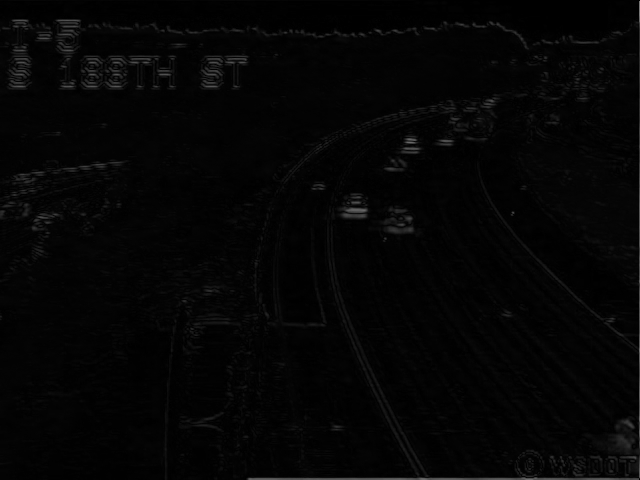

Vehicle Count: 0


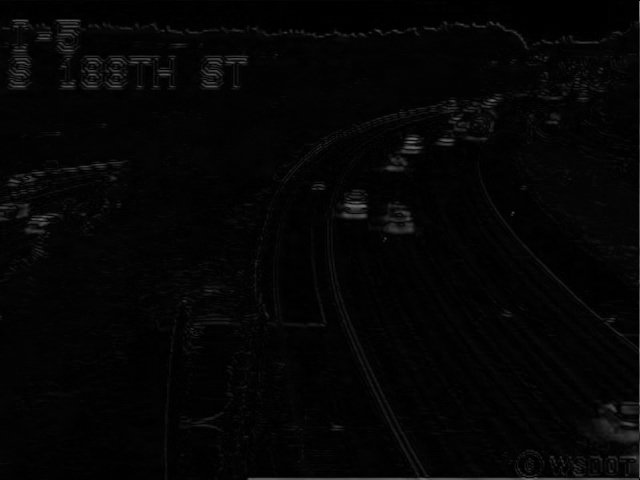

Vehicle Count: 0


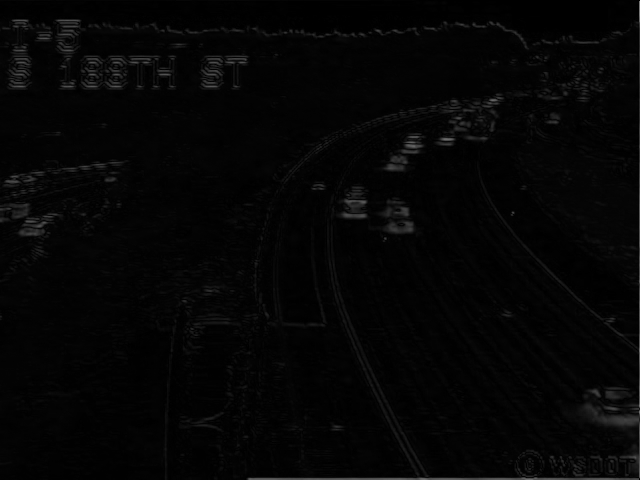

Vehicle Count: 0


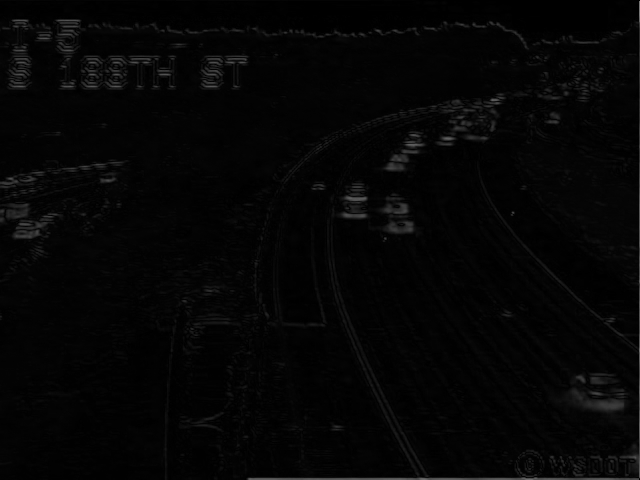

Vehicle Count: 0


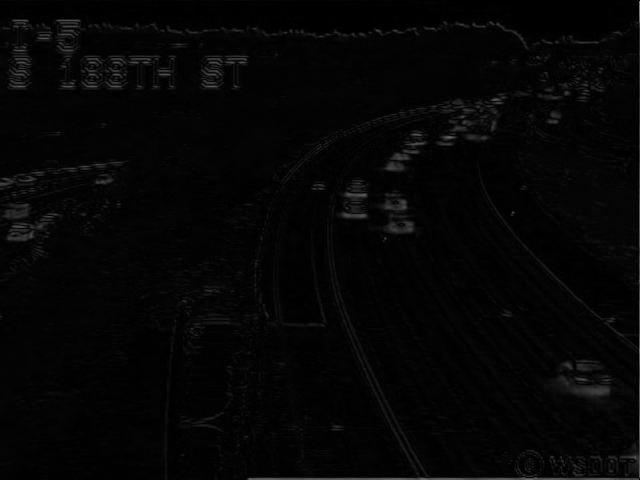

Vehicle Count: 0


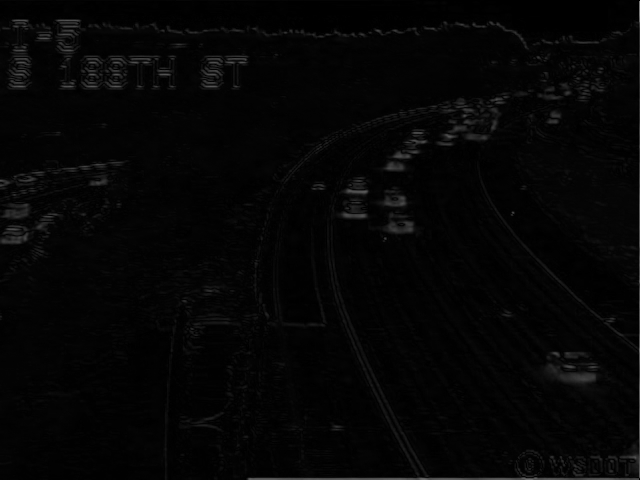

Vehicle Count: 0


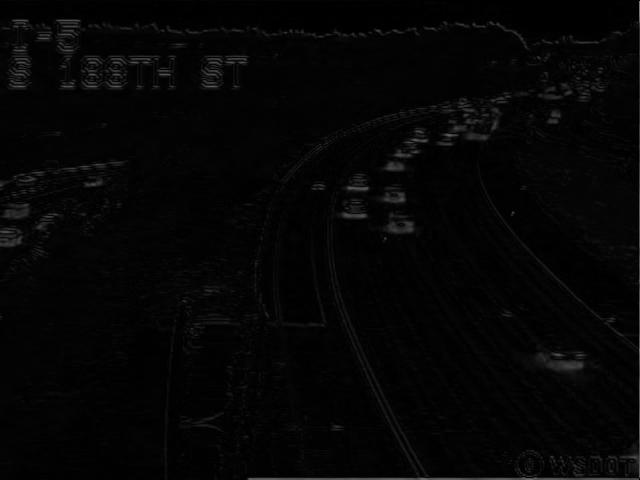

Vehicle Count: 0


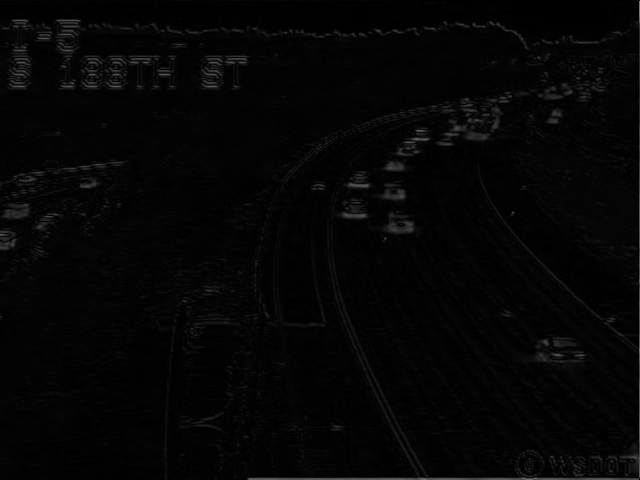

Vehicle Count: 0


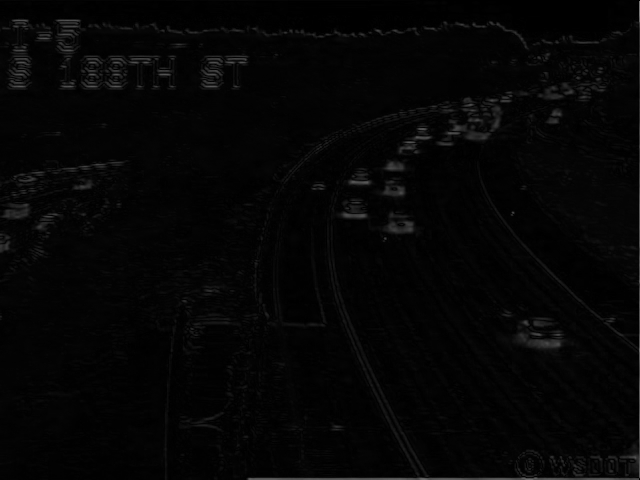

Vehicle Count: 0


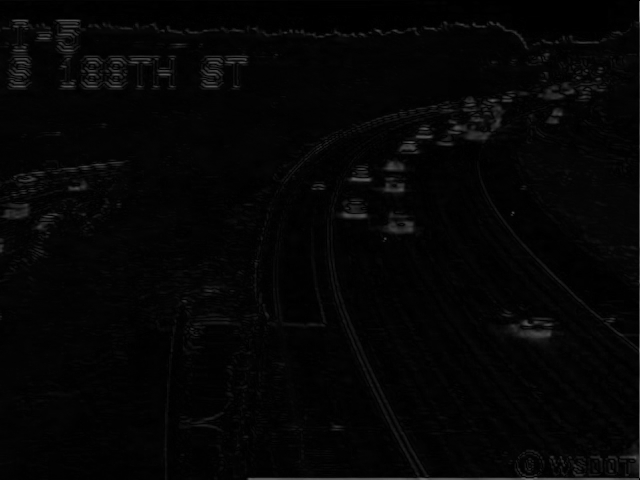

Vehicle Count: 0


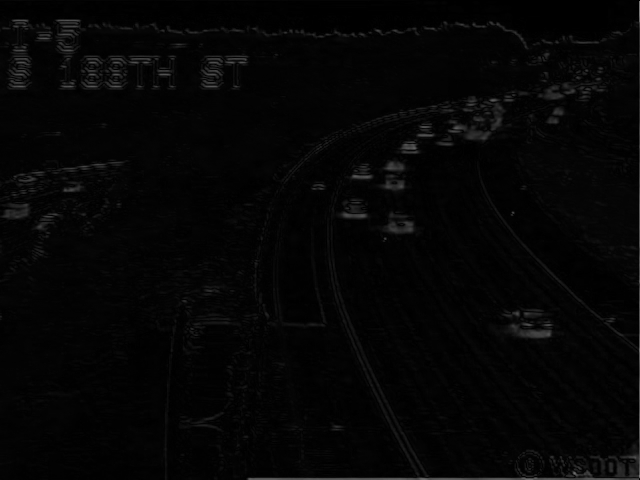

Vehicle Count: 0


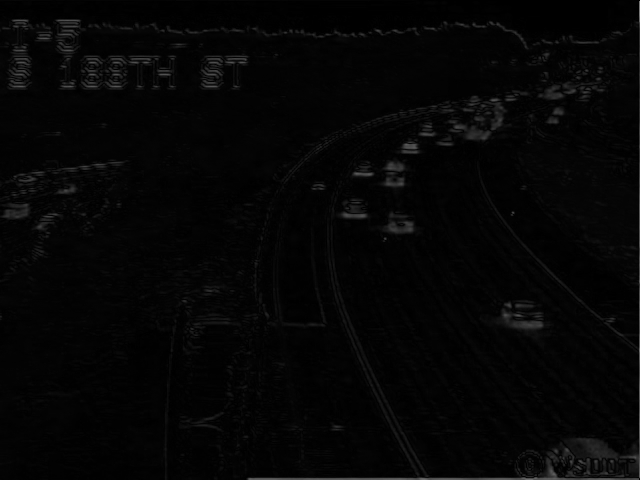

Vehicle Count: 0


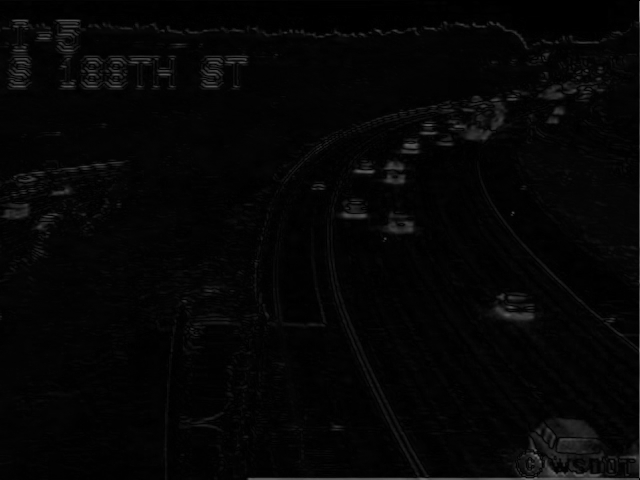

Vehicle Count: 0


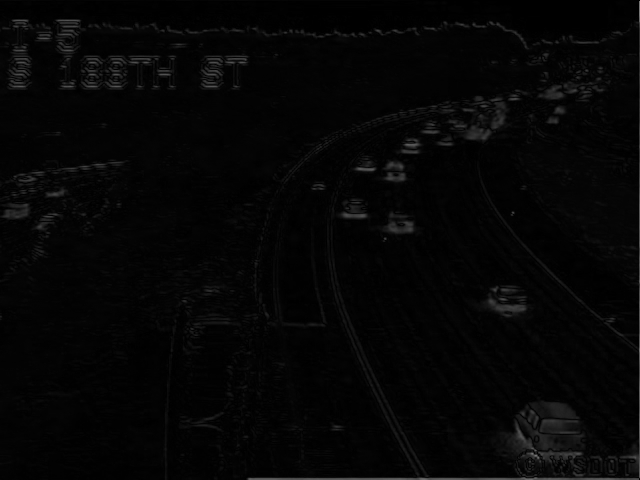

Vehicle Count: 0


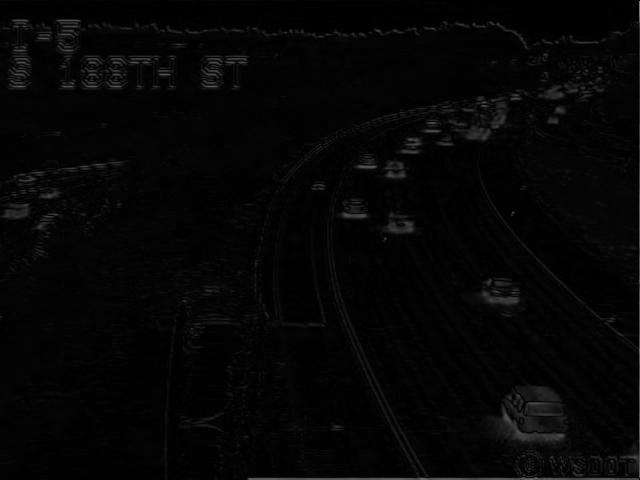

Vehicle Count: 0


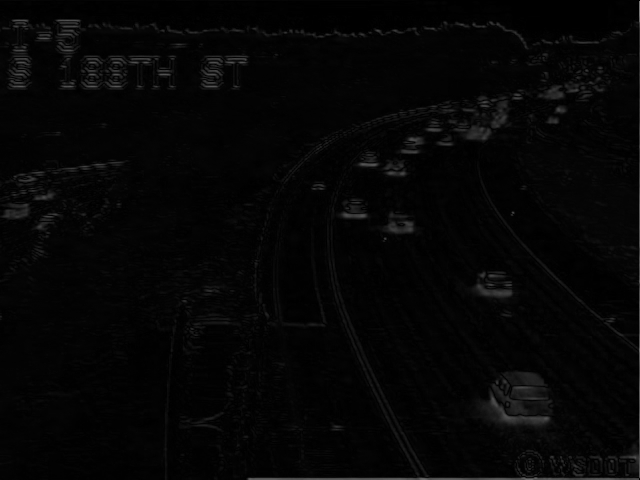

Vehicle Count: 0


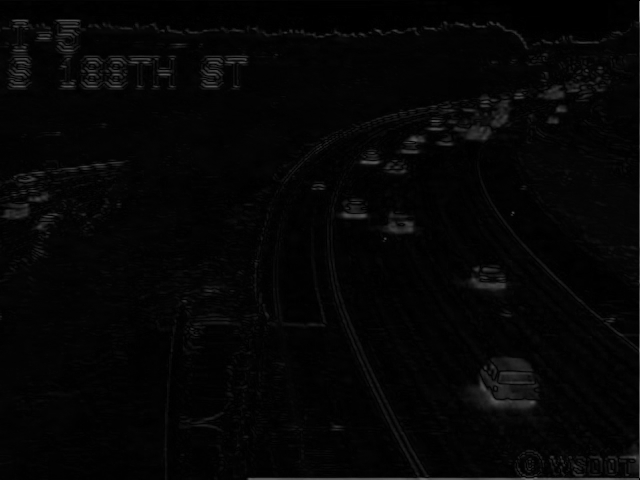

Vehicle Count: 0


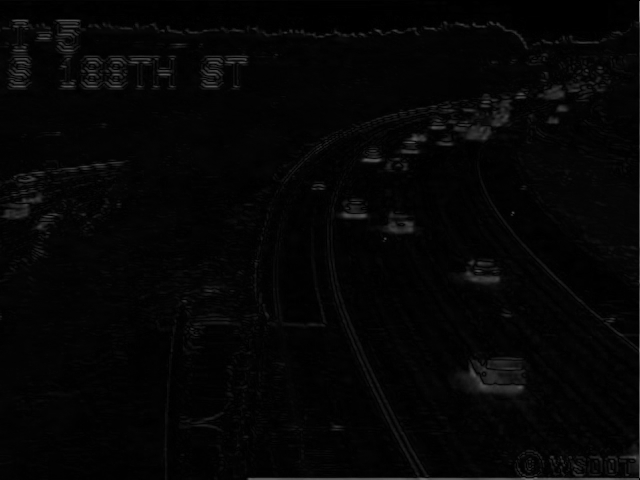

Vehicle Count: 0


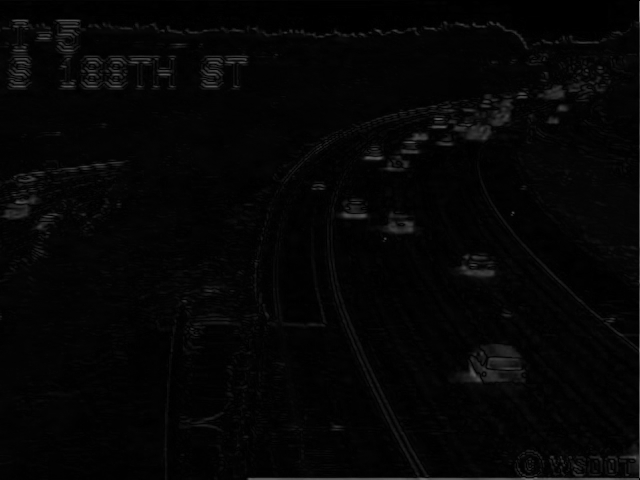

Vehicle Count: 0


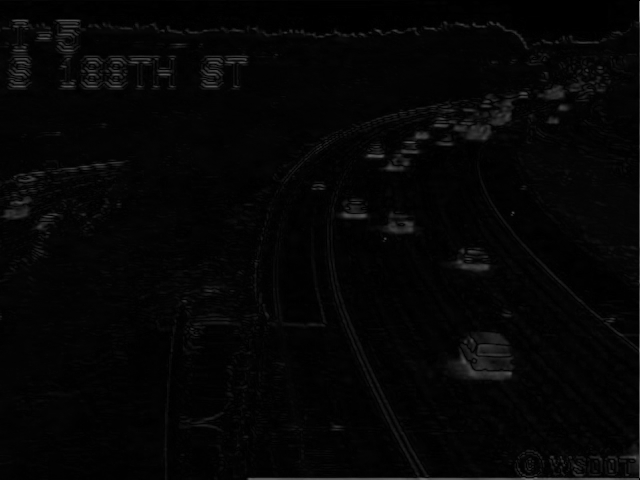

Vehicle Count: 0


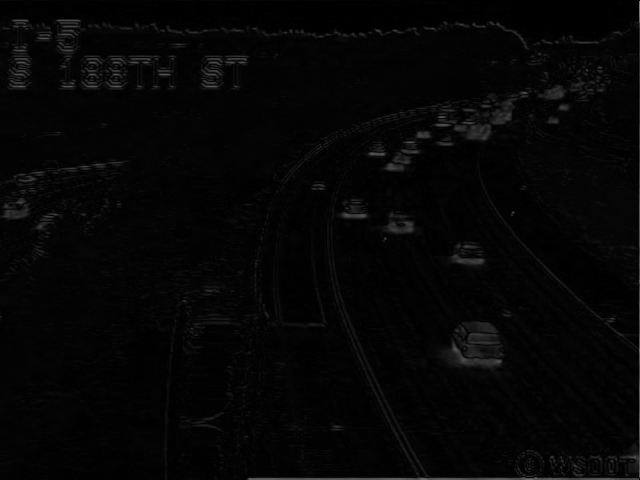

Vehicle Count: 0


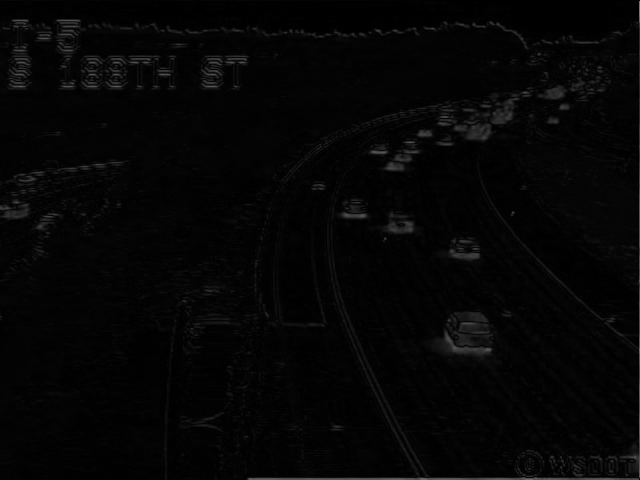

Vehicle Count: 0


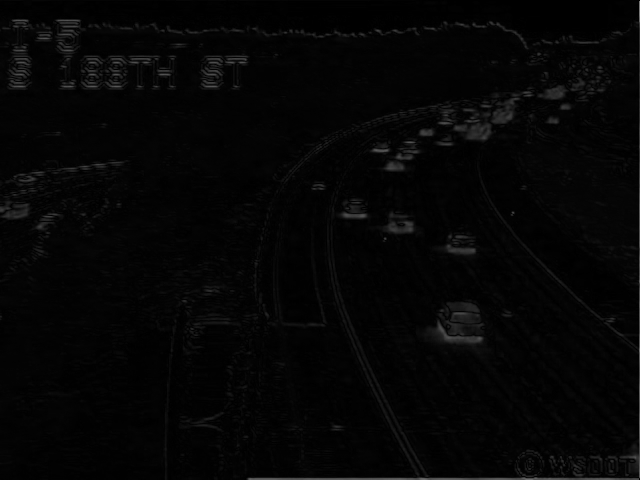

Vehicle Count: 0


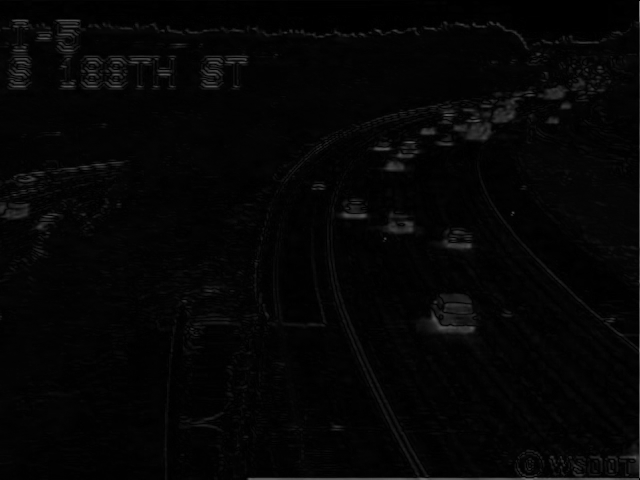

Vehicle Count: 0


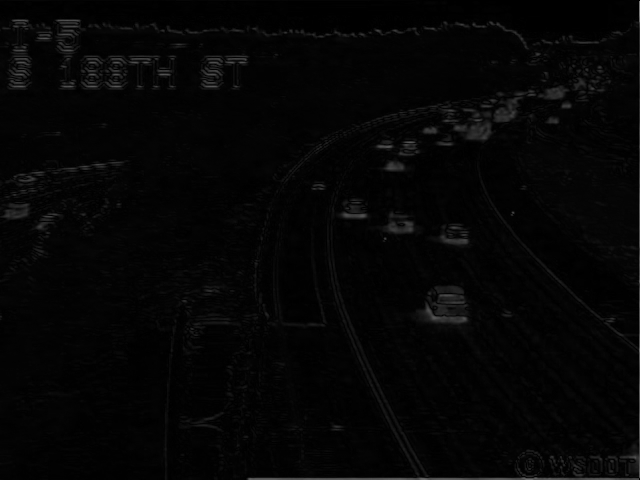

Vehicle Count: 0


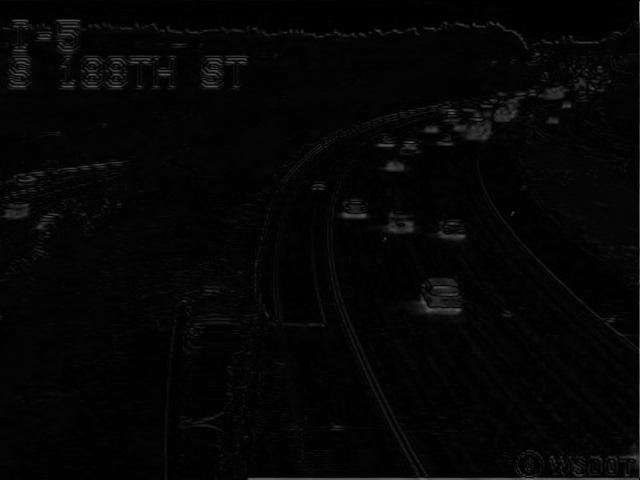

Vehicle Count: 0


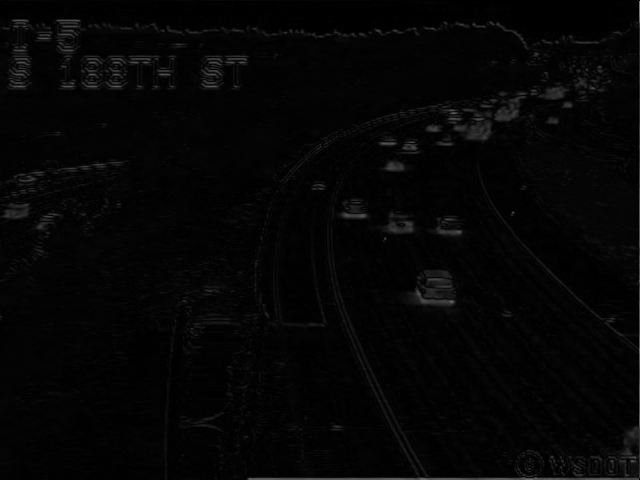

Vehicle Count: 0


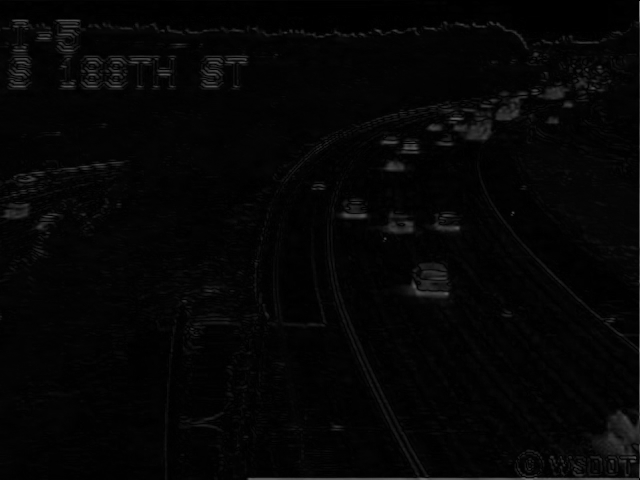

Vehicle Count: 0


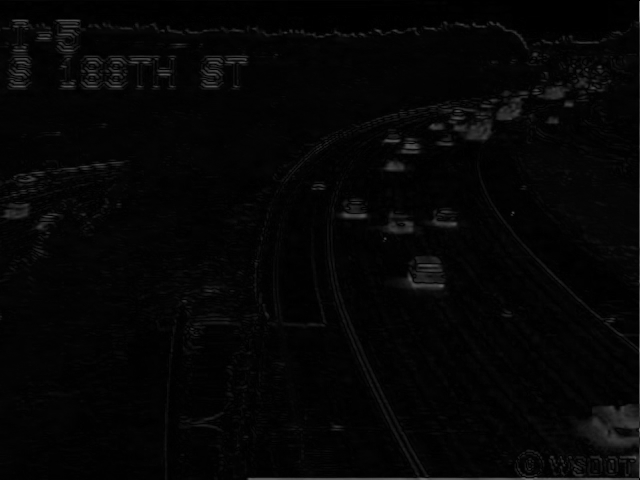

Vehicle Count: 0


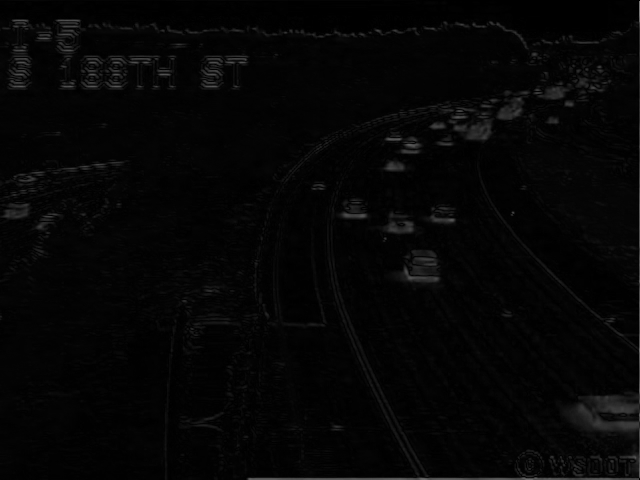

Vehicle Count: 0


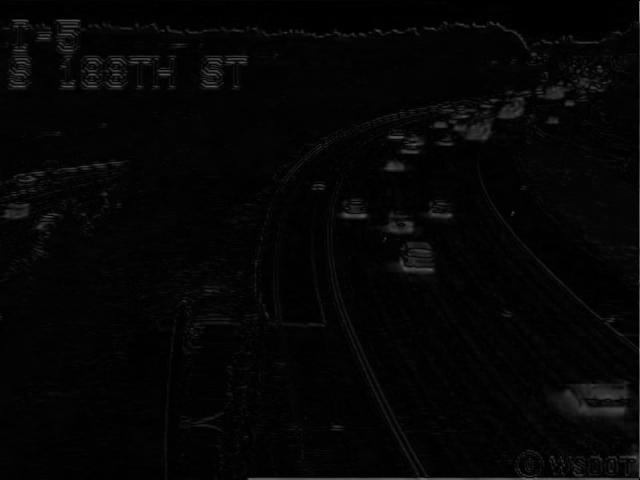

Vehicle Count: 0


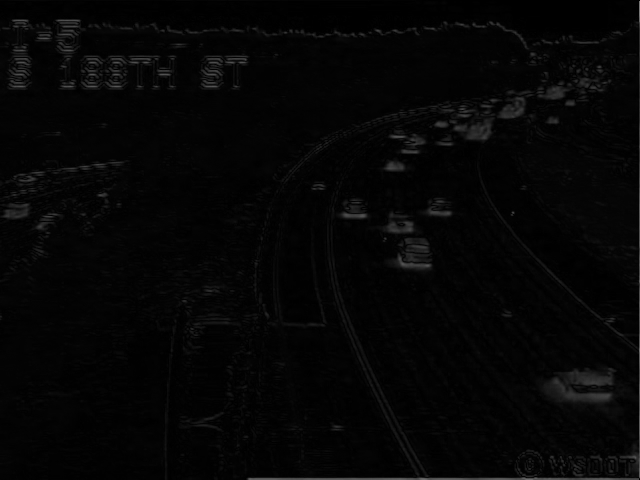

Vehicle Count: 0


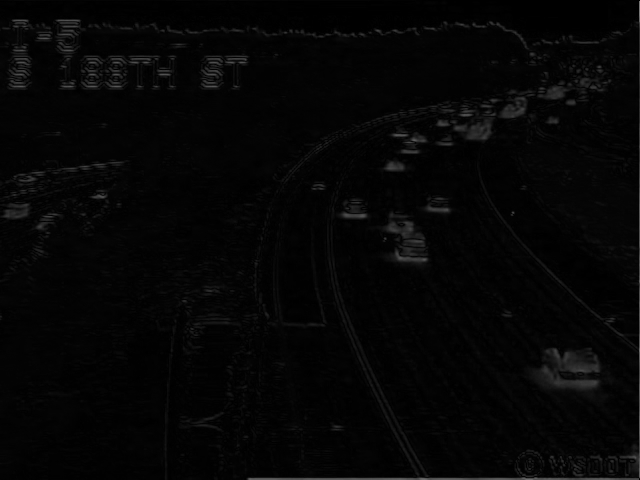

Vehicle Count: 0


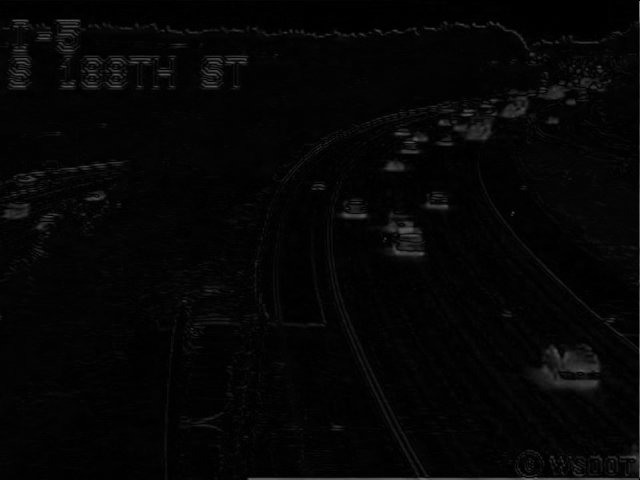

Vehicle Count: 0


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        if len(reference_frame.shape) == 2:
            reference_frame = cv2.cvtColor(reference_frame, cv2.COLOR_GRAY2BGR)
        if len(target_frame.shape) == 2:
            target_frame = cv2.cvtColor(target_frame, cv2.COLOR_GRAY2BGR)
        if target_frame.shape[:2] != reference_frame.shape[:2] or target_frame.shape[2] != reference_frame.shape[2]:
            reference_frame = cv2.resize(reference_frame, (target_frame.shape[1], target_frame.shape[0]))
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def perform_aipf(self, frame):
        aipf_result = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        return aipf_result

    def count_vehicles(self, vehicle_list, direction_final_arrow_geometry):
        vehicle_count = 0
        if vehicle_list is not None:
            for vehicle in vehicle_list:
                if self.check_overlap(vehicle, direction_final_arrow_geometry):
                    vehicle_count += 1
                else:
                    break
        return vehicle_count

    def check_overlap(self, vehicle, direction_final_arrow_geometry):
        return False

    def process_frame(self, target_frame, reference_frame, vehicle_list, direction_final_arrow_geometry):
        fused_image = self.remove_reference_image(target_frame, reference_frame)
        self.update_background_model(fused_image)
        self.update_foreground_model(fused_image)
        fgmask = self.foreground_model.apply(fused_image)
        fgmask = cv2.medianBlur(fgmask, 5)
        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask]*3)
        fusion_image = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)
        aipf_result = self.perform_aipf(fusion_image)
        vehicle_count = self.count_vehicles(vehicle_list, direction_final_arrow_geometry)
        return aipf_result, vehicle_count

video_path = "/content/WhatsApp Video 2024-03-11 at 2.49.06 AM.mp4"
cap = cv2.VideoCapture(video_path)

fusion_image = FusionImage()
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 3.19.37 AM.jpeg")
vehicle_list = []
direction_final_arrow_geometry = []

frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    if frame_count % 3 == 0:
        if len(frame.shape) == 3 and frame.shape[2] == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        aipf_result, vehicle_count = fusion_image.process_frame(frame, reference_image, vehicle_list, direction_final_arrow_geometry)
        cv2_imshow(aipf_result)
        print("Vehicle Count:", vehicle_count)

    frame_count += 1

cap.release()
cv2.destroyAllWindows()


Number of vehicles:  11.0


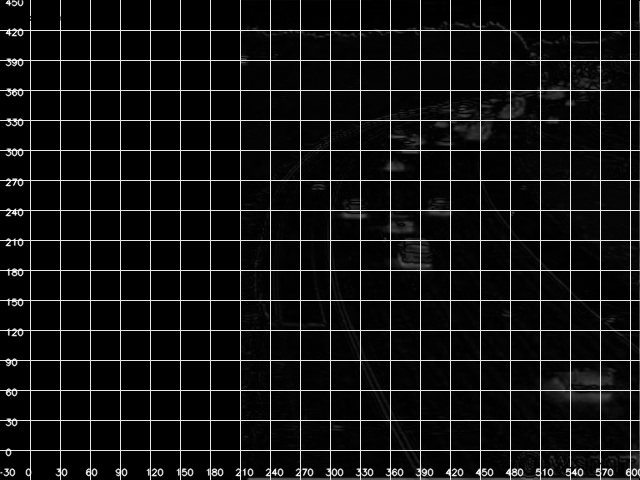

0.09370994567871094


In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import time

start=time.time()
def divide_image_into_grids(image_path, grid_size_mm):
    image = cv2.imread(image_path)
    pixels_per_mm = 1
    grid_size_pixels = int(grid_size_mm * pixels_per_mm)
    height, width, _ = image.shape
    num_rows = int(np.ceil(height / grid_size_pixels))
    num_cols = int(np.ceil(width / grid_size_pixels))
    cv2.rectangle(image, (0, 0), (240, height), (0, 0, 0), -1)
    vehicle_count = 0
    for i in range(num_rows):
        for j in range(num_cols):
            x = j * grid_size_pixels
            y = i * grid_size_pixels
            if 360 <= x <= 600 and 0 <= y < 120:
                cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
                if np.any(cell != [0, 0, 0]):
                    vehicle_count += 1/9
            elif 300 <= x <= 450 and 120 <= y <= 270:
                cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
                if np.any(cell != [0, 0, 0]):
                    vehicle_count += 1/5
    print("Number of vehicles: ",np.floor(vehicle_count))
    for i in range(1, num_rows):
        y = i * grid_size_pixels
        cv2.line(image, (0, y), (width, y), (230, 230, 230), 1)

    for j in range(1, num_cols):
        x = j * grid_size_pixels
        cv2.line(image, (x, 0), (x, height), (230, 230, 230), 1)

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.3
    font_thickness = 1
    font_color = (0, 0, 0)

    cv2.putText(image, 'X-axis (mm)', (width - 80, height - 10), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    cv2.putText(image, 'Y-axis (mm)', (10, 20), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    for j in range(num_cols):
        x = j * grid_size_pixels
        cv2.putText(image, str((j-1) * grid_size_mm), (x - 5, height - 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    for i in range(num_rows):
        y = i * grid_size_pixels
        cv2.putText(image, str((num_rows - i - 1) * grid_size_mm), (5, y + 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    cv2_imshow(image)

image_path = '/content/download.png'
grid_size_mm = 30
divide_image_into_grids(image_path, grid_size_mm)

end = time.time()

print(end-start)


Number of vehicles: 1.0


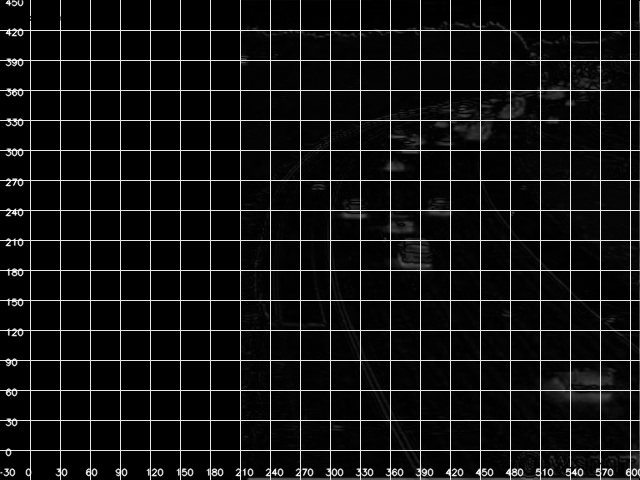

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

def divide_image_into_grids(image_path, grid_size_mm):
    image = cv2.imread(image_path)

    pixels_per_mm = 1
    grid_size_pixels = int(grid_size_mm * pixels_per_mm)
    height, width, _ = image.shape
    num_rows = int(np.ceil(height / grid_size_pixels))
    num_cols = int(np.ceil(width / grid_size_pixels))
    cv2.rectangle(image, (0, 0), (240, height), (0, 0, 0), -1)
    vehicle_count = 0
    for i in range(num_rows):
        for j in range(num_cols):
            x = i* grid_size_pixels
            y = j* grid_size_pixels
            if 390 <= x <= 600 and 0 <= y <= 100:
                cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
                if np.any(cell != [0, 0, 0]):
                    vehicle_count += 1/9
    vehicle_count=np.floor(vehicle_count)
    print(f"Number of vehicles: {vehicle_count}")
    for i in range(1, num_rows):
        y = i * grid_size_pixels
        cv2.line(image, (0, y), (width, y), (230, 230, 230), 1)

    for j in range(1, num_cols):
        x = j * grid_size_pixels
        cv2.line(image, (x, 0), (x, height), (230, 230, 230), 1)

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.3
    font_thickness = 1
    font_color = (0, 0, 0)

    cv2.putText(image, 'X-axis (mm)', (width - 80, height - 10), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    cv2.putText(image, 'Y-axis (mm)', (10, 20), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    for j in range(num_cols):
        x = j * grid_size_pixels
        cv2.putText(image, str((j-1) * grid_size_mm), (x - 5, height - 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    for i in range(num_rows):
        y = i * grid_size_pixels
        cv2.putText(image, str((num_rows - i - 1) * grid_size_mm), (5, y + 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    cv2_imshow(image)

image_path = '/content/download.png'
# original_image=''
grid_size_mm = 30
divide_image_into_grids(image_path, grid_size_mm)
# divide_image_into_grids(original_image, grid_size_mm)


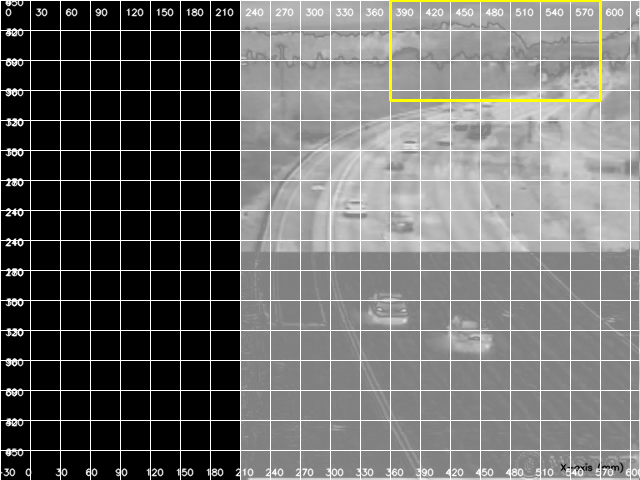

Vehicle Count: 1.0


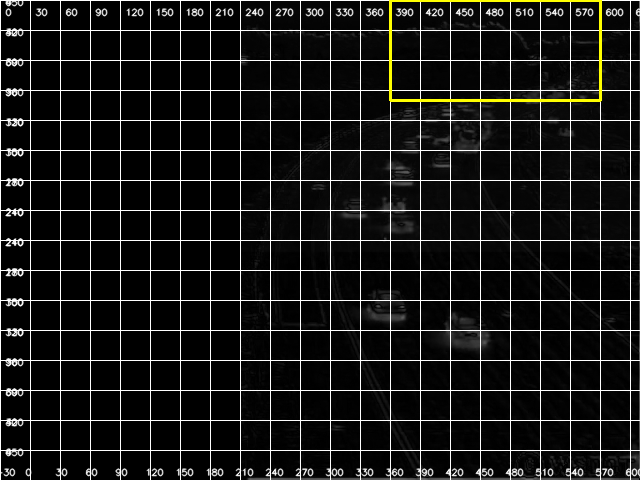

Vehicle Count: 1.0


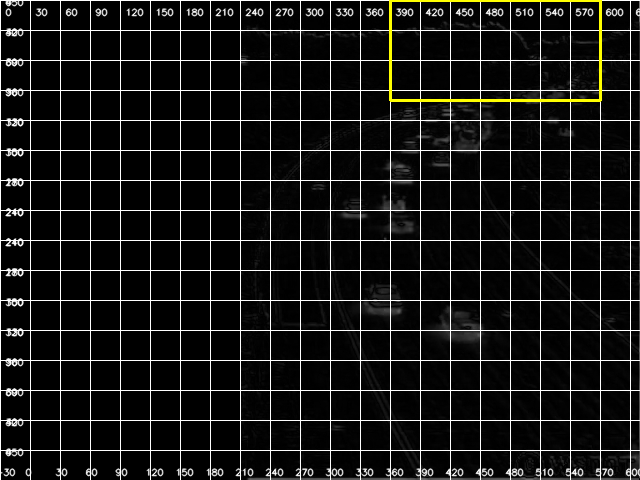

Vehicle Count: 1.0


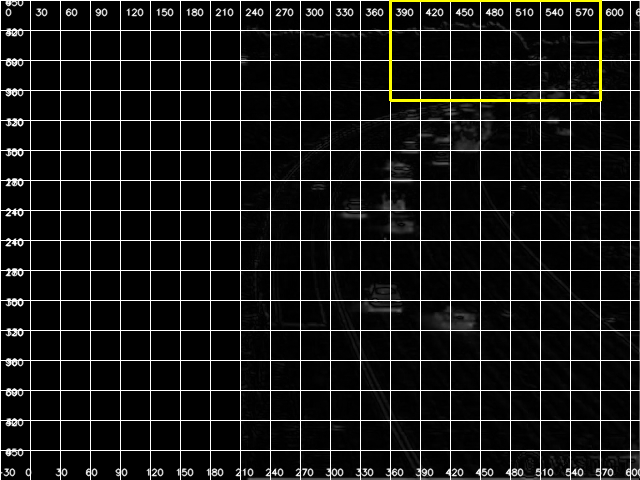

Vehicle Count: 1.0


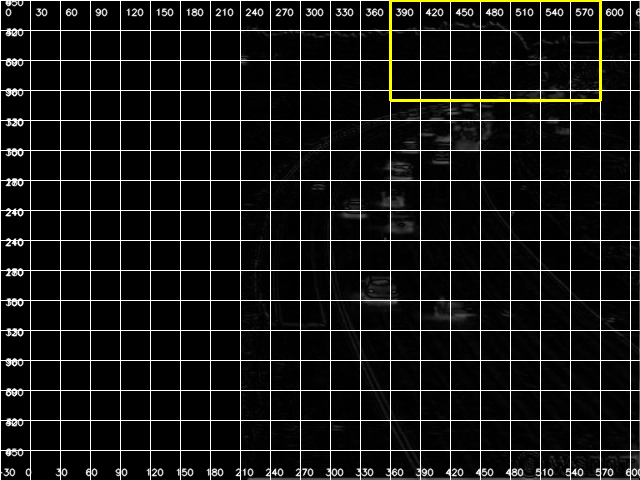

Vehicle Count: 1.0


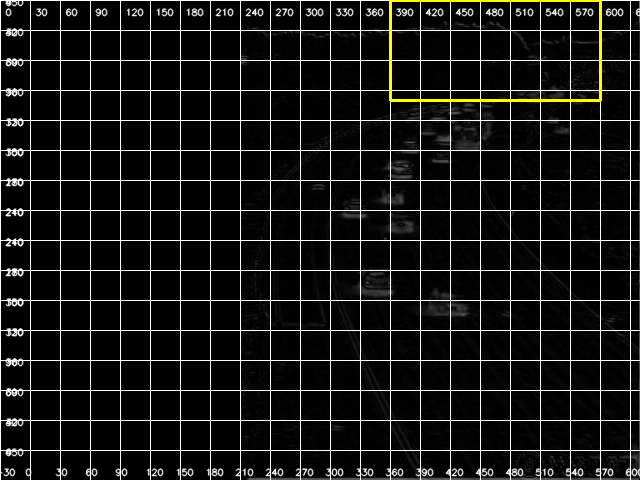

Vehicle Count: 1.0


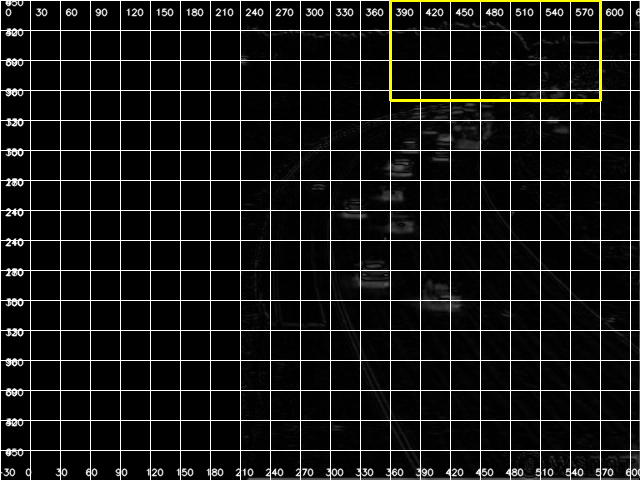

Vehicle Count: 1.0


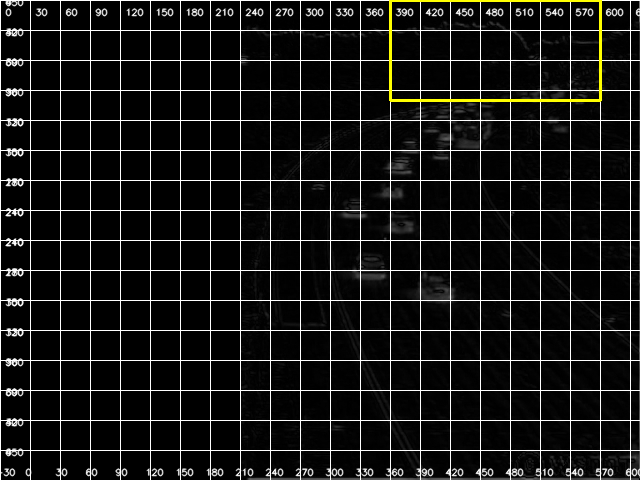

Vehicle Count: 1.0


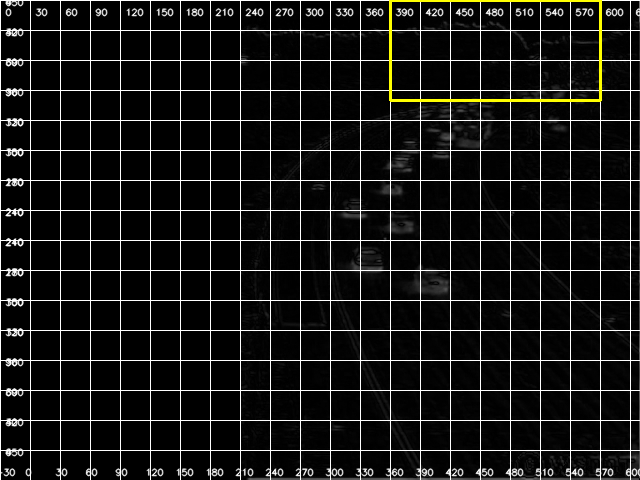

Vehicle Count: 1.0


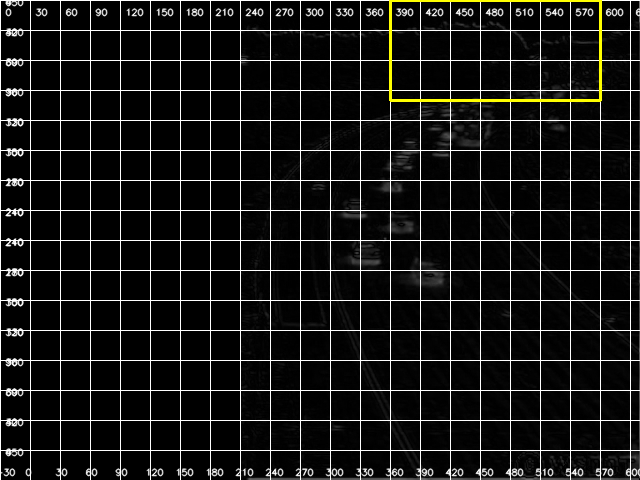

Vehicle Count: 1.0


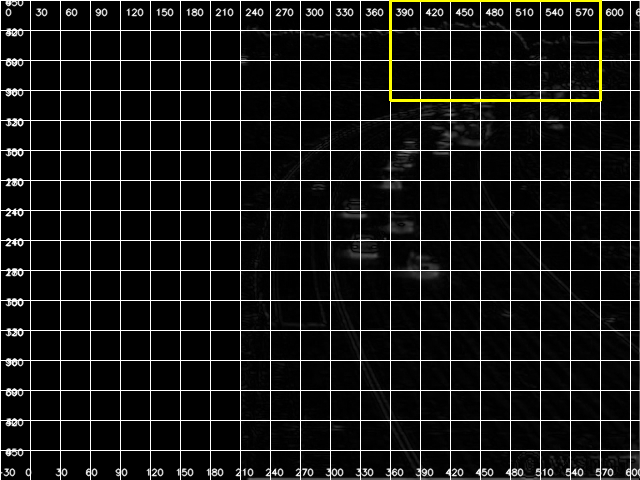

Vehicle Count: 1.0


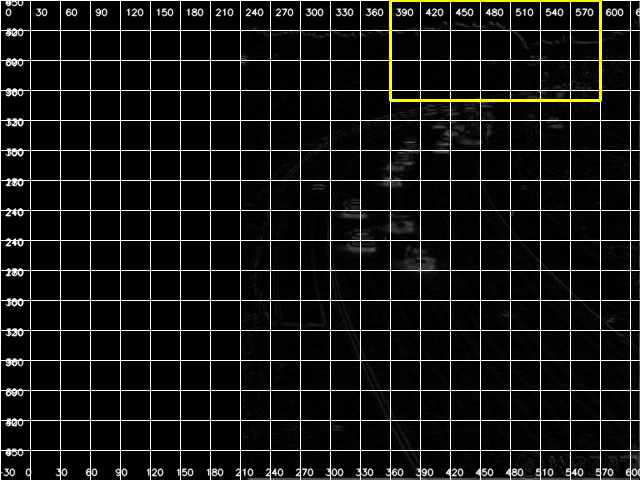

Vehicle Count: 1.0


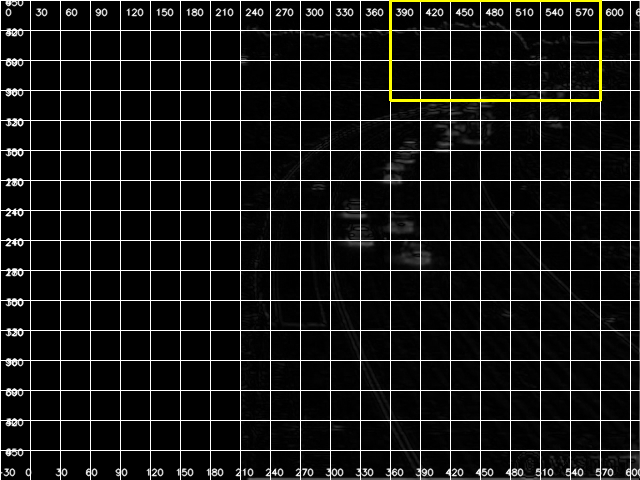

Vehicle Count: 1.0


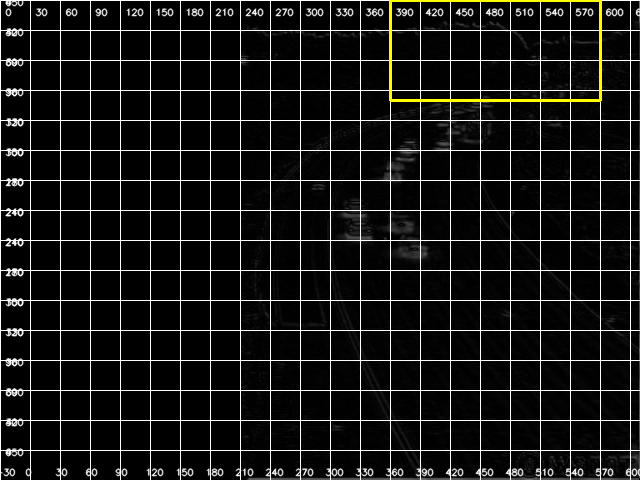

Vehicle Count: 1.0


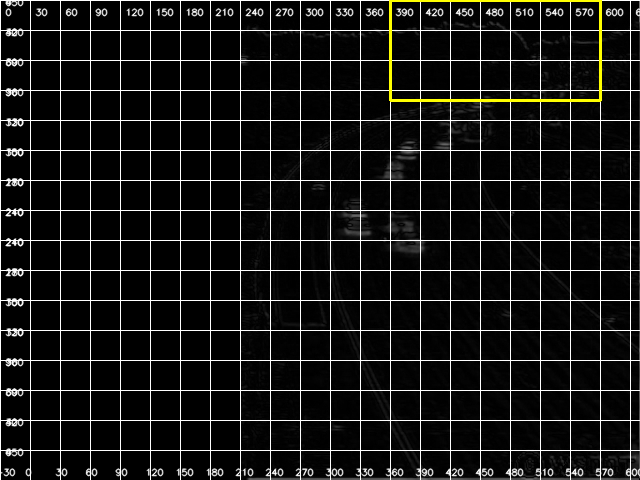

Vehicle Count: 1.0


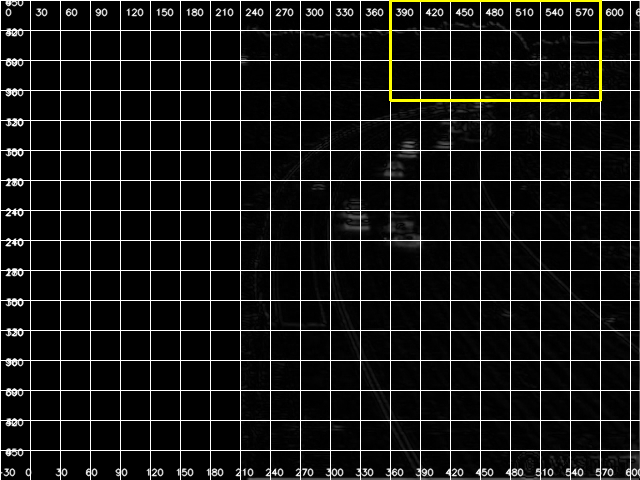

Vehicle Count: 1.0


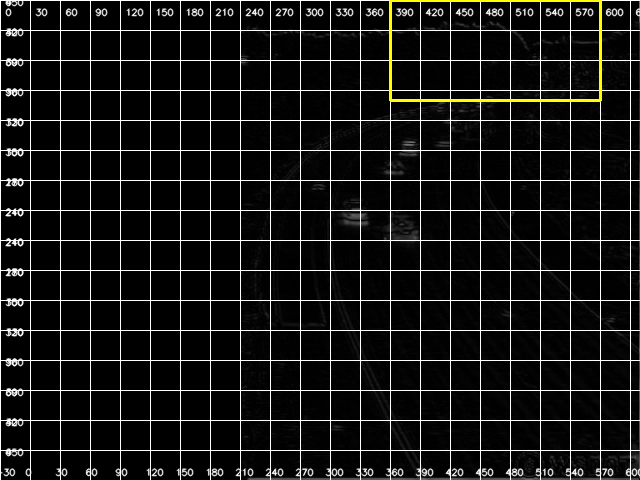

Vehicle Count: 1.0


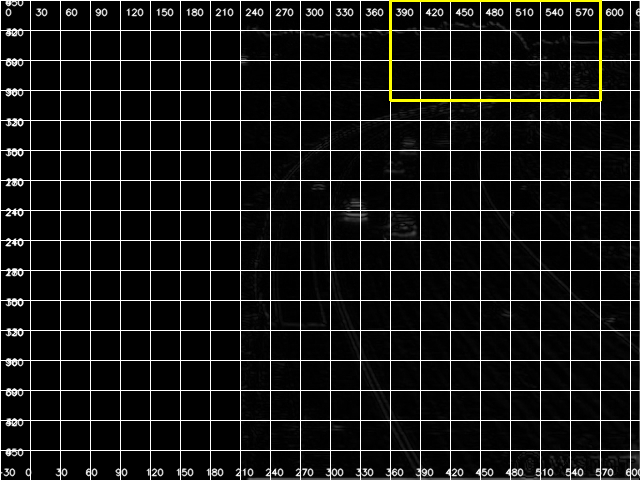

Vehicle Count: 1.0


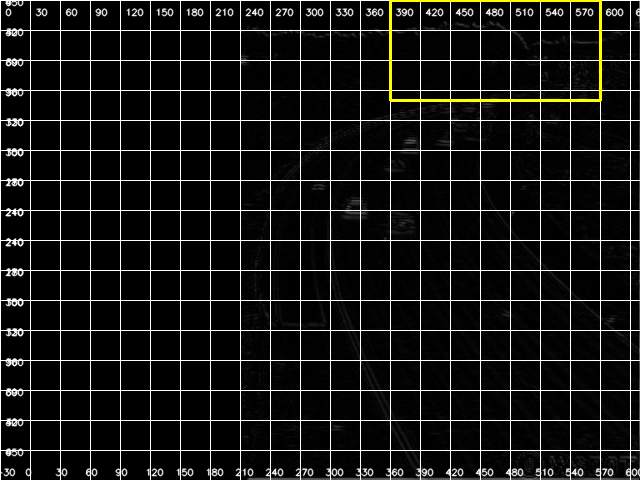

Vehicle Count: 1.0


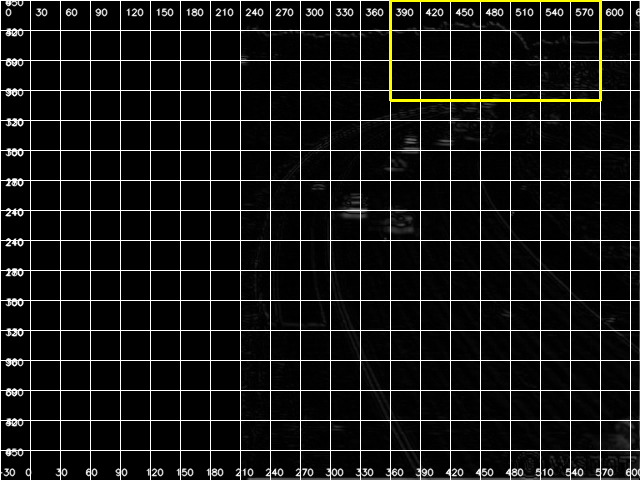

Vehicle Count: 1.0


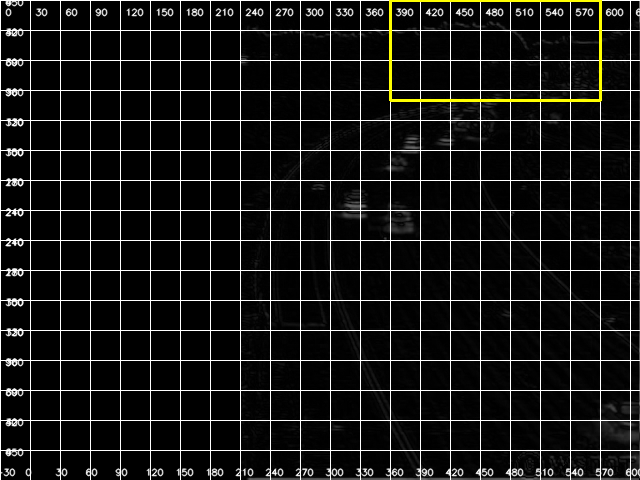

Vehicle Count: 1.0


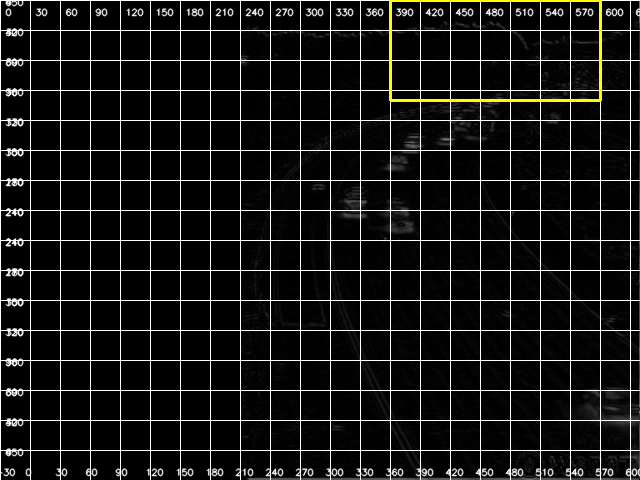

Vehicle Count: 1.0


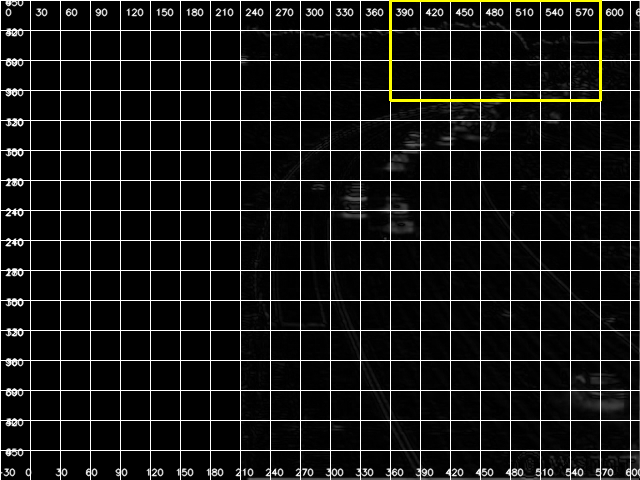

Vehicle Count: 1.0


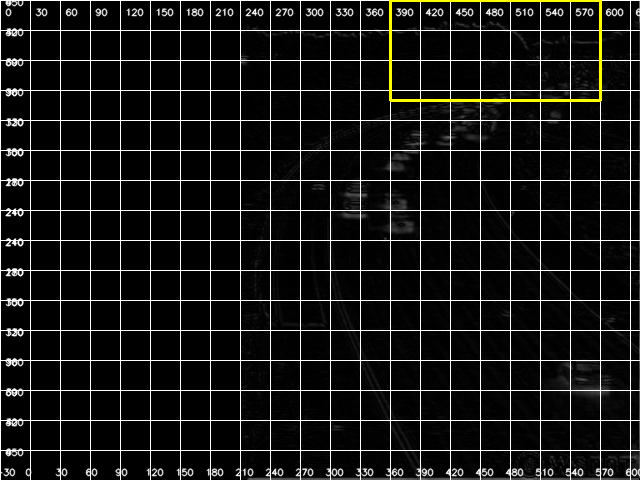

Vehicle Count: 1.0


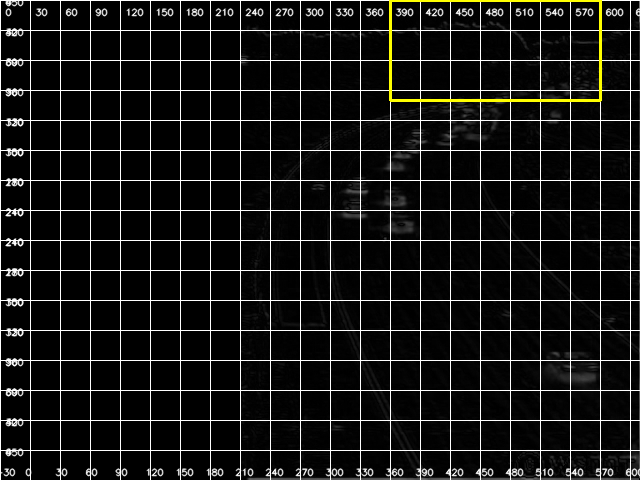

Vehicle Count: 1.0


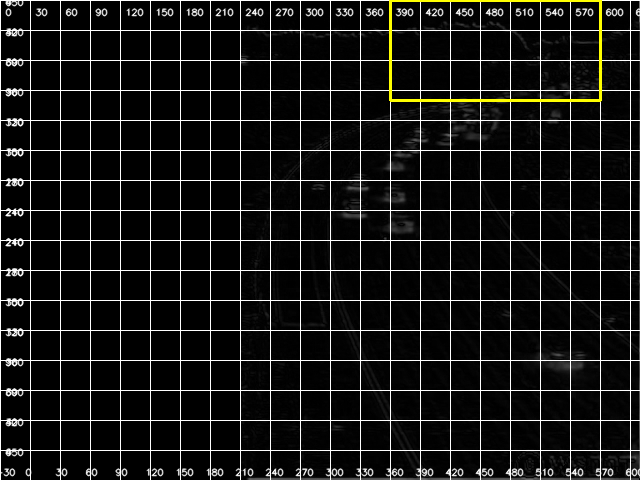

Vehicle Count: 1.0


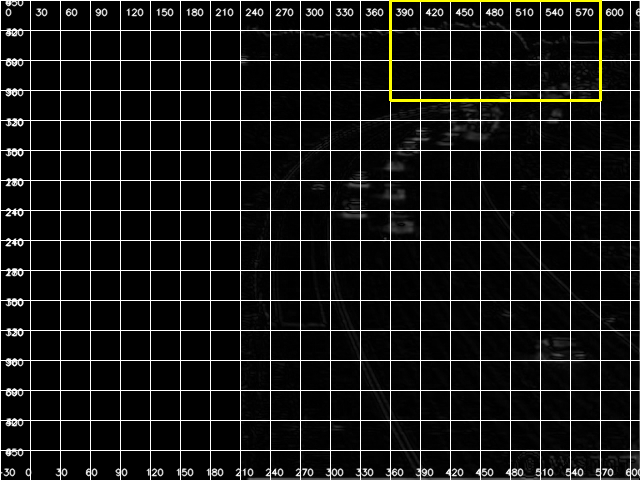

Vehicle Count: 1.0


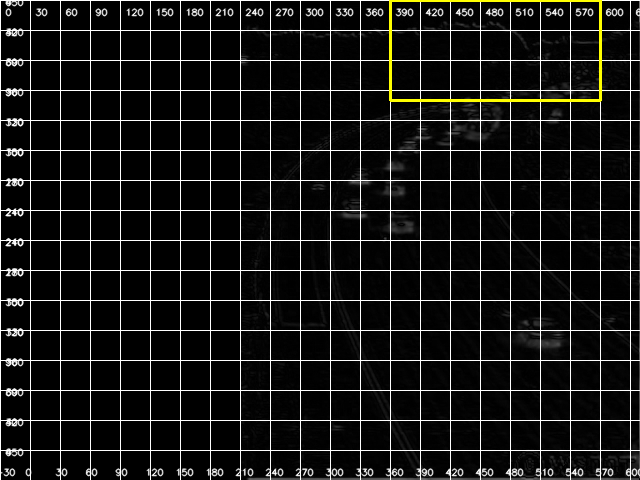

Vehicle Count: 1.0


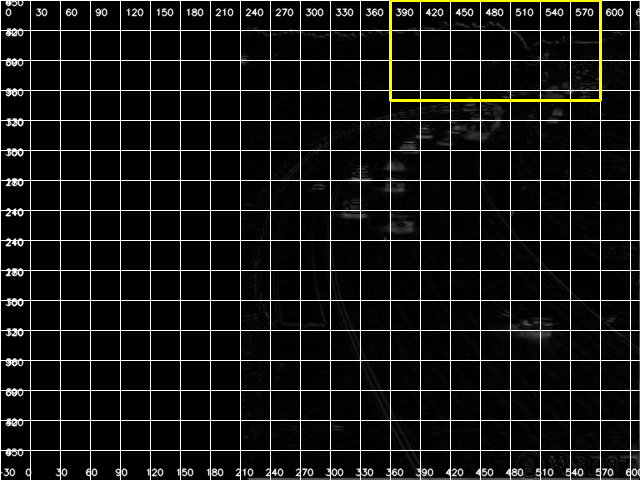

Vehicle Count: 1.0


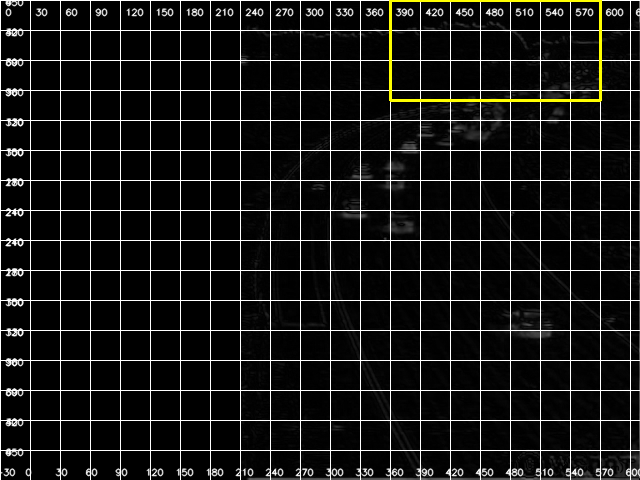

Vehicle Count: 1.0


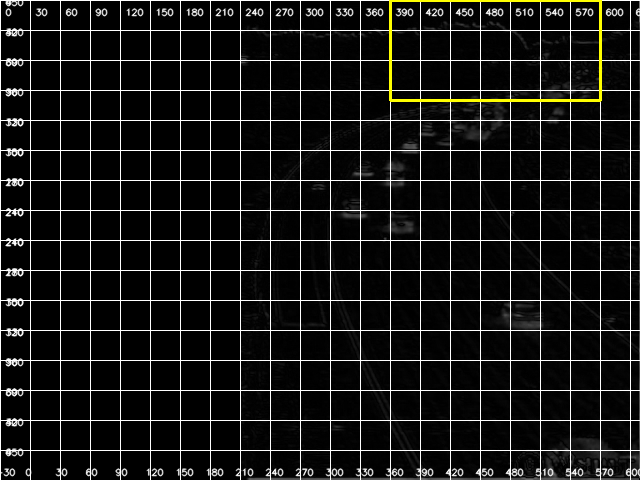

Vehicle Count: 1.0


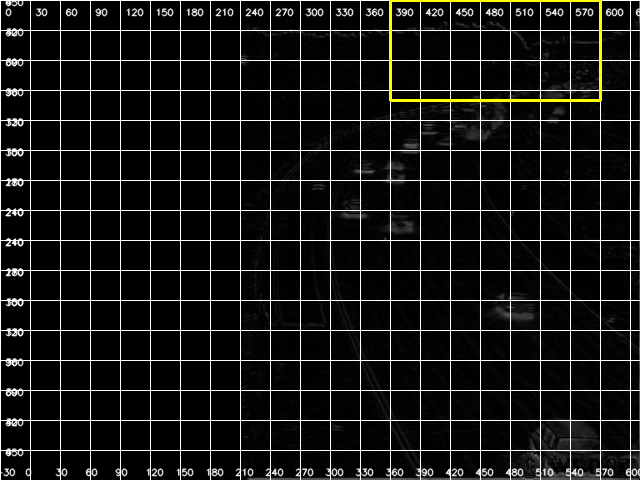

Vehicle Count: 1.0


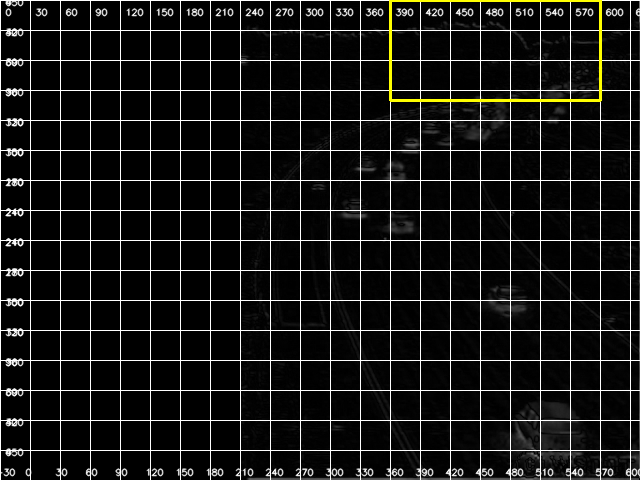

Vehicle Count: 1.0


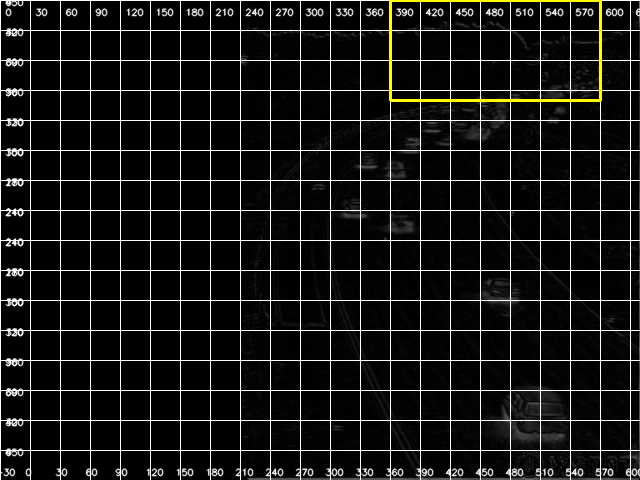

Vehicle Count: 1.0


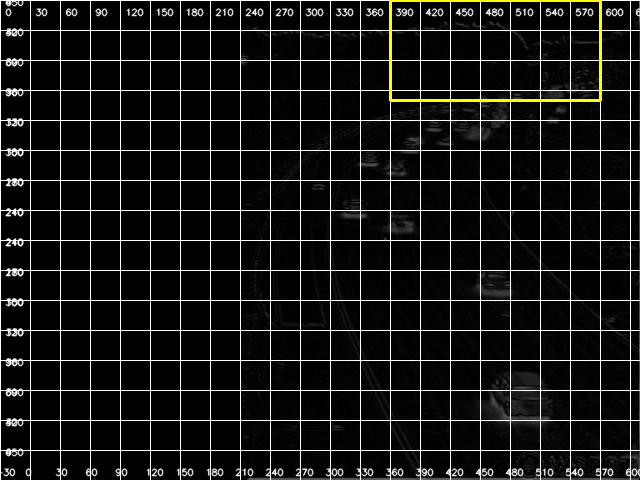

Vehicle Count: 1.0


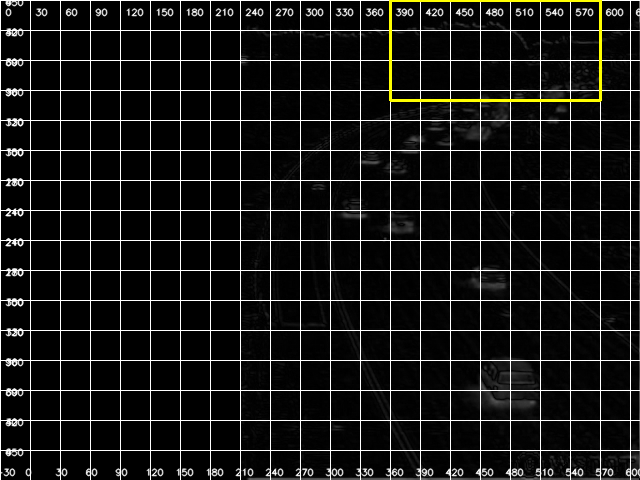

Vehicle Count: 1.0


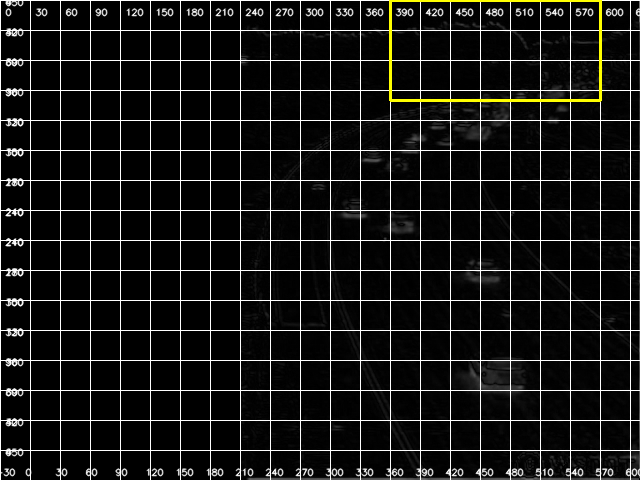

Vehicle Count: 1.0


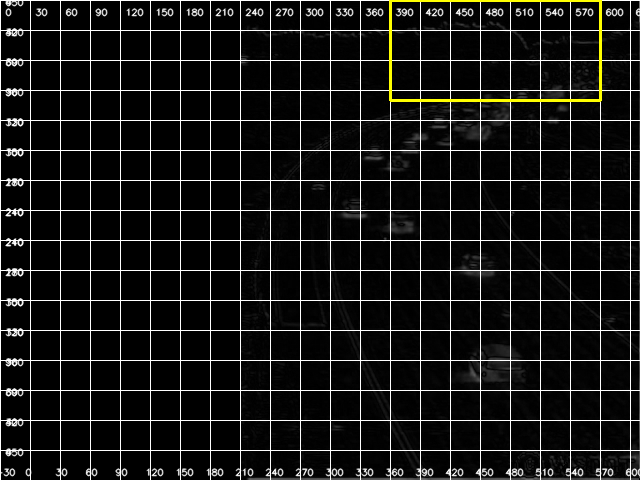

Vehicle Count: 1.0


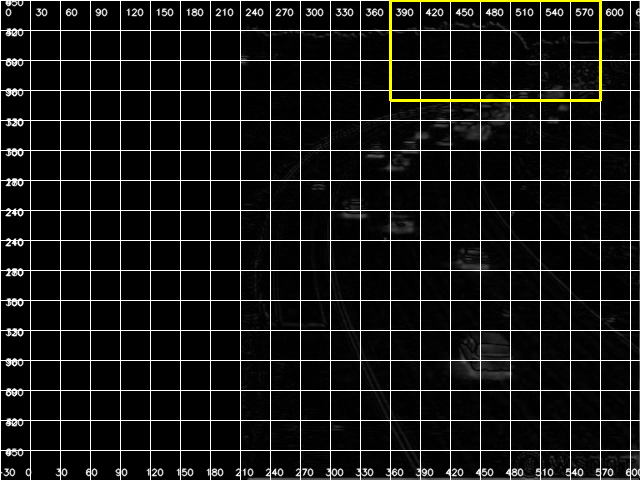

Vehicle Count: 1.0


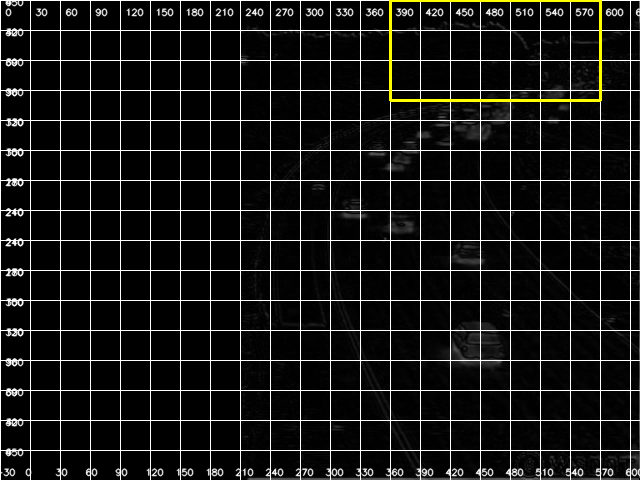

Vehicle Count: 1.0


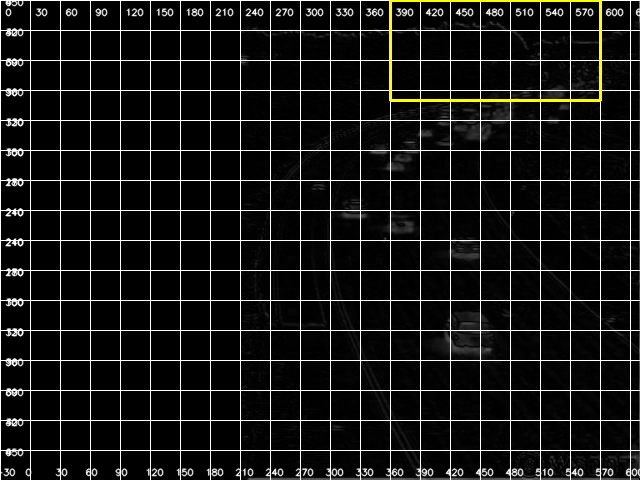

Vehicle Count: 1.0


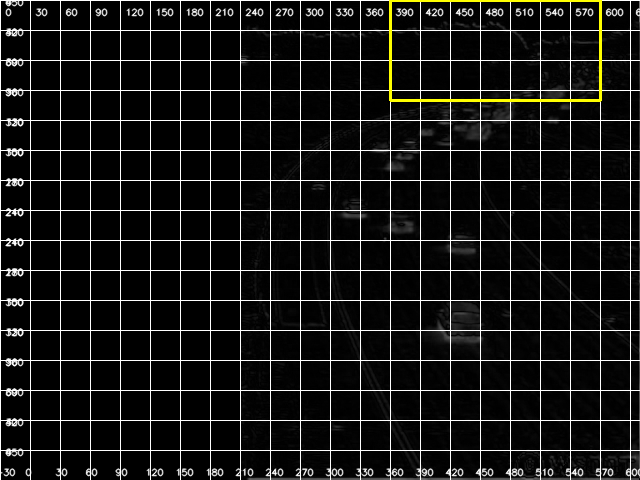

Vehicle Count: 1.0


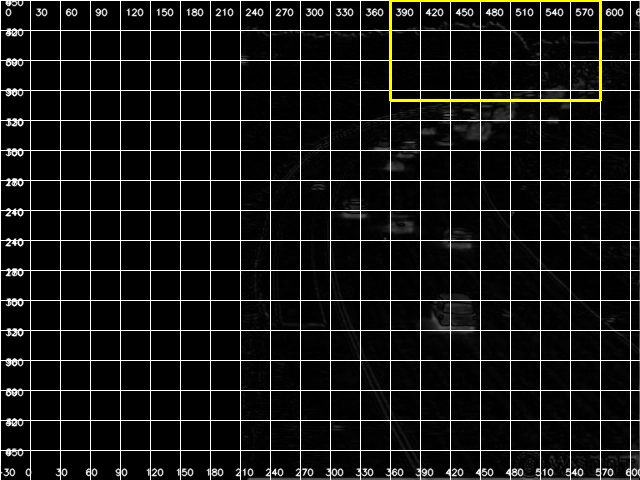

Vehicle Count: 1.0


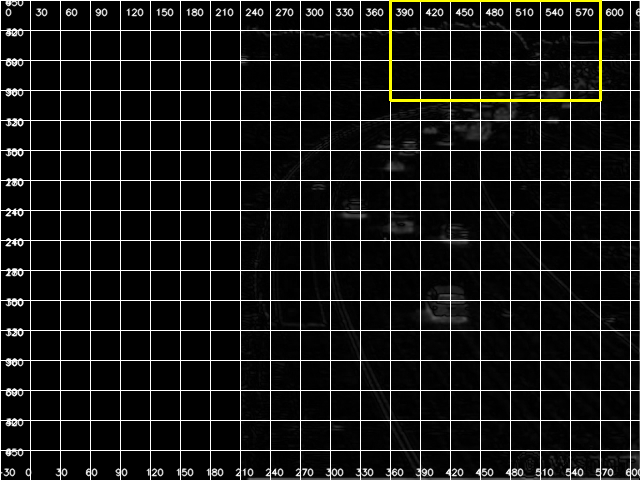

Vehicle Count: 1.0


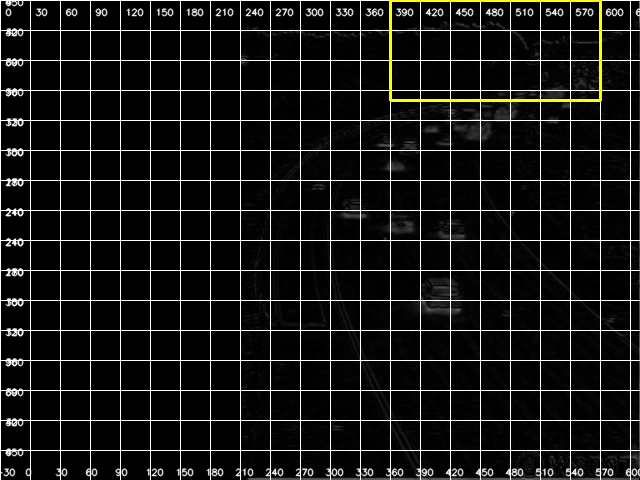

Vehicle Count: 1.0


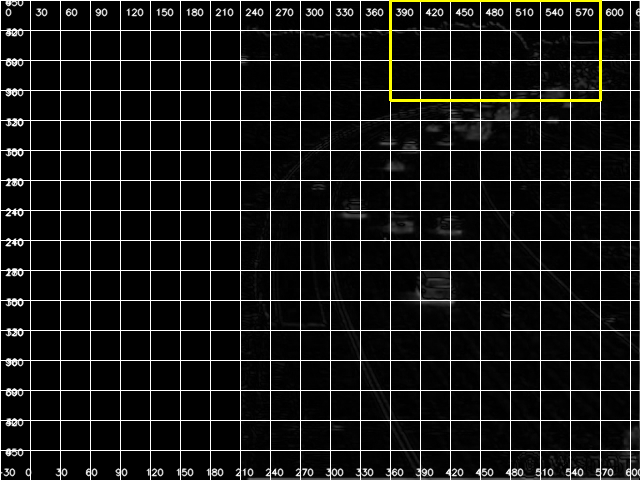

Vehicle Count: 1.0


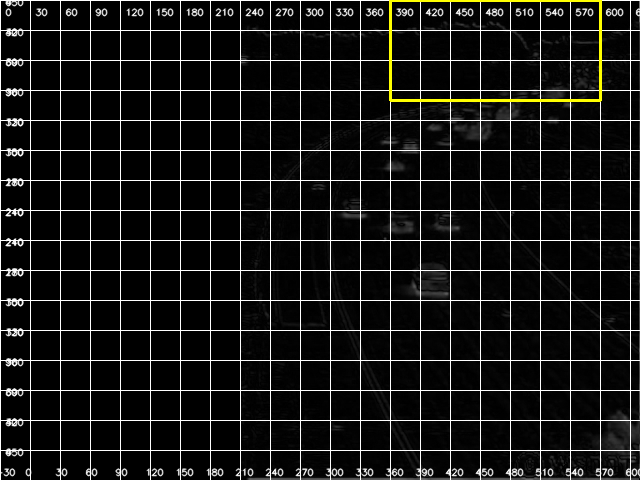

Vehicle Count: 1.0


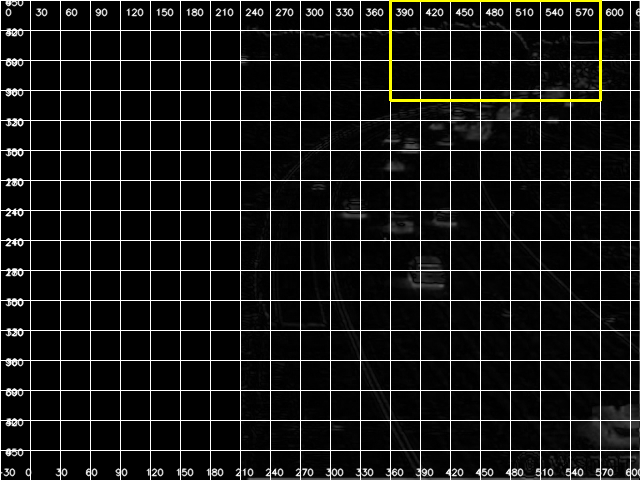

Vehicle Count: 1.0


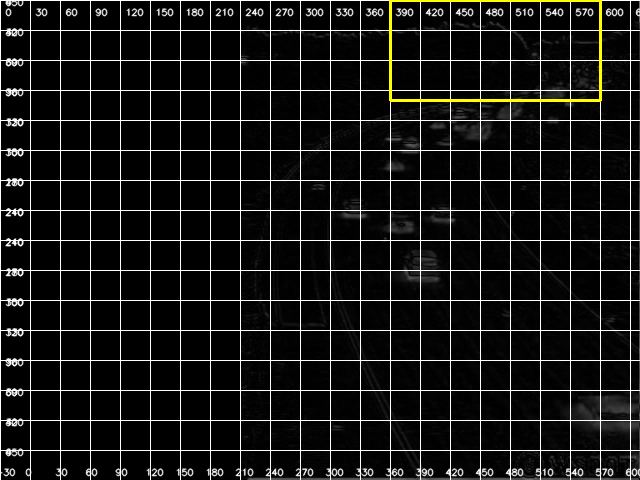

Vehicle Count: 1.0


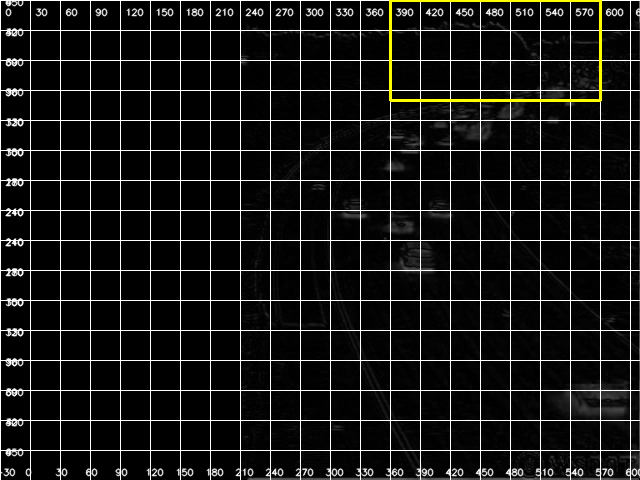

Vehicle Count: 1.0


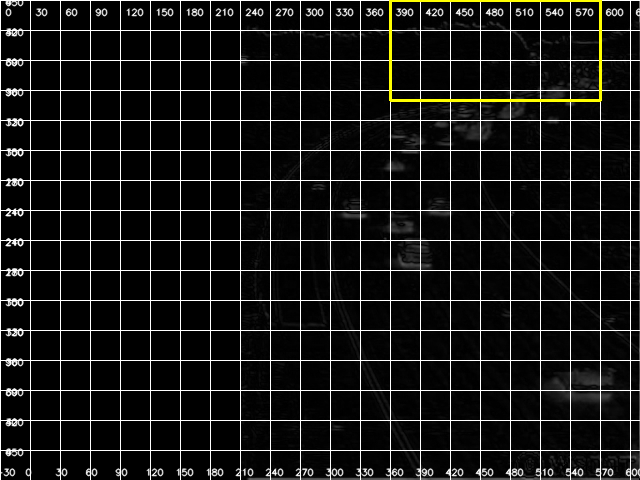

Vehicle Count: 1.0


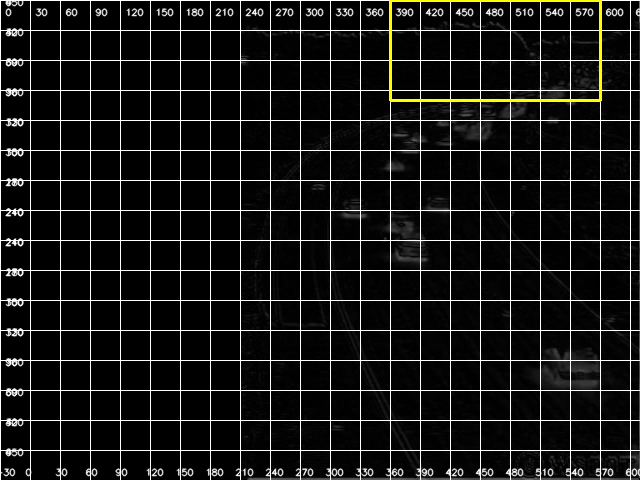

Vehicle Count: 1.0


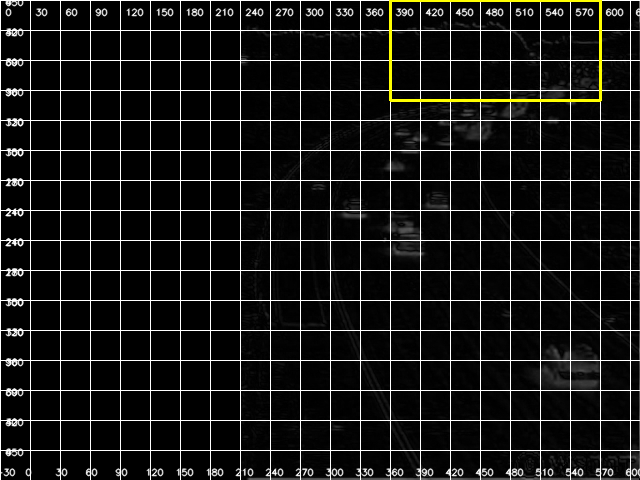

Vehicle Count: 1.0


In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

class FusionImage:
    def __init__(self, alpha=0.5, beta=0.5):
        self.alpha = alpha
        self.beta = beta
        self.background_model = None
        self.foreground_model = None

    def update_background_model(self, frame):
        if self.background_model is None:
            self.background_model = frame.copy().astype("float32")
        else:
            cv2.accumulateWeighted(frame, self.background_model, 0.9)

    def update_foreground_model(self, frame):
        if self.foreground_model is None:
            self.foreground_model = cv2.createBackgroundSubtractorMOG2(history=5, varThreshold=40, detectShadows=False)
        else:
            self.foreground_model.apply(frame)

    def calculate_raw_gradient(self, frame):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gradient_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        raw_gradient = cv2.magnitude(gradient_x, gradient_y)
        return raw_gradient

    def calculate_normalized_gradient(self, raw_gradient):
        normalized_gradient = cv2.normalize(raw_gradient, None, 0, 255, cv2.NORM_MINMAX)
        normalized_gradient = normalized_gradient.astype("uint8")
        return normalized_gradient

    def remove_reference_image(self, target_frame, reference_frame):
        if len(reference_frame.shape) == 2:
            reference_frame = cv2.cvtColor(reference_frame, cv2.COLOR_GRAY2BGR)
        if len(target_frame.shape) == 2:
            target_frame = cv2.cvtColor(target_frame, cv2.COLOR_GRAY2BGR)
        if target_frame.shape[:2] != reference_frame.shape[:2] or target_frame.shape[2] != reference_frame.shape[2]:
            reference_frame = cv2.resize(reference_frame, (target_frame.shape[1], target_frame.shape[0]))
        result = cv2.absdiff(target_frame, reference_frame)
        return result

    def perform_aipf(self, frame):
        aipf_result = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        return aipf_result

    def count_vehicles(self, aipf_result, grid_size_mm):
        image = aipf_result

        pixels_per_mm = 1
        grid_size_pixels = int(grid_size_mm * pixels_per_mm)

        # Check if the image is grayscale or color
        if len(image.shape) == 3:
            height, width, _ = image.shape
        else:
            height, width = image.shape
            image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)  # Convert grayscale to BGR

        num_rows = int(np.ceil(height / grid_size_pixels))
        num_cols = int(np.ceil(width / grid_size_pixels))
        cv2.rectangle(image, (0, 0), (240, height), (0, 0, 0), -1)

        # Highlight the specified region with yellow color
        cv2.rectangle(image, (390, 0), (600, 100), (0, 255, 255), 2)

        vehicle_count = 0
        for i in range(num_rows):
            for j in range(num_cols):
                x = i * grid_size_pixels
                y = j * grid_size_pixels
                if 390 <= x <= 600 and 0 <= y <= 100:
                    cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
                    if np.any(cell != [0, 0, 0]):
                        vehicle_count += 1/9
        vehicle_count = np.floor(vehicle_count)
        for i in range(1, num_rows):
            y = i * grid_size_pixels
            cv2.line(image, (0, y), (width, y), (230, 230, 230), 1)

        for j in range(1, num_cols):
            x = j * grid_size_pixels
            cv2.line(image, (x, 0), (x, height), (230, 230, 230), 1)

        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 0.3
        font_thickness = 1
        font_color = (0, 0, 0)

        cv2.putText(image, 'X-axis (mm)', (width - 80, height - 10), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
        cv2.putText(image, 'Y-axis (mm)', (10, 20), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
        for j in range(num_cols):
            x = j * grid_size_pixels
            cv2.putText(image, str((j-1) * grid_size_mm), (x - 5, height - 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
        for i in range(num_rows):
            y = i * grid_size_pixels
            cv2.putText(image, str((num_rows - i - 1) * grid_size_mm), (5, y + 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
        return vehicle_count, image

    def process_frame(self, target_frame, reference_frame, grid_size_mm):
        fused_image = self.remove_reference_image(target_frame, reference_frame)
        self.update_background_model(fused_image)
        self.update_foreground_model(fused_image)
        fgmask = self.foreground_model.apply(fused_image)
        fgmask = cv2.medianBlur(fgmask, 5)
        background = self.background_model.astype("uint8")
        foreground = cv2.merge([fgmask] * 3)
        fusion_image = cv2.addWeighted(background, self.alpha, foreground, self.beta, 0)
        aipf_result = self.perform_aipf(fusion_image)

        _, otsu_result = cv2.threshold(cv2.cvtColor(fusion_image, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        hole_filled_result = self.fill_holes(otsu_result)

        vehicle_count, grid_image = self.count_vehicles(aipf_result, grid_size_mm)

        # Draw grid lines and their dimensions on the aipf_result
        grid_size_pixels = int(grid_size_mm) # Assuming 1 pixel = 1 mm for simplicity
        height, width = aipf_result.shape
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 0.3
        font_thickness = 1
        font_color = (255, 255, 255) # White color

        for i in range(0, height, grid_size_pixels):
            cv2.line(grid_image, (0, i), (width, i), (255, 255, 255), 1) # Horizontal lines
            cv2.putText(grid_image, f"{i}", (5, i + 5), font, font_scale, font_color, font_thickness, cv2.LINE_AA)

        for j in range(0, width, grid_size_pixels):
            cv2.line(grid_image, (j, 0), (j, height), (255, 255, 255), 1) # Vertical lines
            cv2.putText(grid_image, f"{j}", (j + 5, 15), font, font_scale, font_color, font_thickness, cv2.LINE_AA)

        return aipf_result, vehicle_count, grid_image

    def fill_holes(self, binary_image):
        contours, hierarchy = cv2.findContours(binary_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        for i in range(len(contours)):
            cv2.drawContours(binary_image, contours, i, 255, thickness=cv2.FILLED, lineType=cv2.LINE_8, hierarchy=hierarchy, maxLevel=0)

        return binary_image


video_path = "/content/WhatsApp Video 2024-03-11 at 2.49.06 AM.mp4"
cap = cv2.VideoCapture(video_path)

fusion_image = FusionImage()
reference_image = cv2.imread("/content/WhatsApp Image 2024-03-11 at 3.19.37 AM.jpeg")
grid_size_mm = 30

frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    if frame_count % 3 == 0:
        aipf_result, vehicle_count, grid_image = fusion_image.process_frame(frame, reference_image, grid_size_mm)

        # Highlight the specified region with yellow color
        cv2.rectangle(grid_image, (390, 0), (600, 100), (0, 255, 255), 2)

        cv2_imshow(grid_image)
        print("Vehicle Count:", vehicle_count)
        vehicle_count = 0

    frame_count += 1
cap.release()
cv2.destroyAllWindows()

Number of vehicles: 2.0


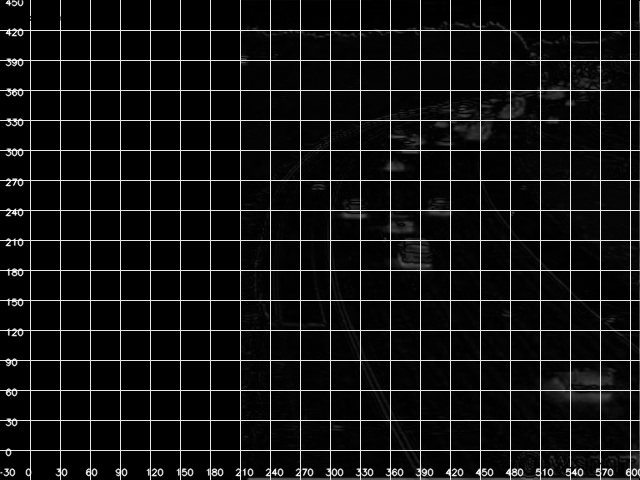

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

def divide_image_into_grids(image_path, grid_size_mm):
    image = cv2.imread(image_path)

    pixels_per_mm = 1
    grid_size_pixels = int(grid_size_mm * pixels_per_mm)
    height, width, _ = image.shape
    num_rows = int(np.ceil(height / grid_size_pixels))
    num_cols = int(np.ceil(width / grid_size_pixels))
    cv2.rectangle(image, (0, 0), (240, height), (0, 0, 0), -1)
    vehicle_count = 0
    for i in range(num_rows):
        for j in range(num_cols):
            x = i* grid_size_pixels
            y = j* grid_size_pixels
            if 390 <= x <= 600 and 0 <= y <= 210:
                cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
                if np.any(cell != [0, 0, 0]):
                    vehicle_count += 1/9
            # elif 330 <= x <= 510 and 120 <= y <= 180:
            #     cell = image[y:y+grid_size_pixels, x:x+grid_size_pixels]
            #     if np.any(cell != [0, 0, 0]):
            #         vehicle_count += 1/5
    vehicle_count=np.floor(vehicle_count)
    print(f"Number of vehicles: {vehicle_count}")
    for i in range(1, num_rows):
        y = i * grid_size_pixels
        cv2.line(image, (0, y), (width, y), (230, 230, 230), 1)

    for j in range(1, num_cols):
        x = j * grid_size_pixels
        cv2.line(image, (x, 0), (x, height), (230, 230, 230), 1)

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.3
    font_thickness = 1
    font_color = (0, 0, 0)

    cv2.putText(image, 'X-axis (mm)', (width - 80, height - 10), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    cv2.putText(image, 'Y-axis (mm)', (10, 20), font, font_scale, font_color, font_thickness, cv2.LINE_AA)
    for j in range(num_cols):
        x = j * grid_size_pixels
        cv2.putText(image, str((j-1) * grid_size_mm), (x - 5, height - 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    for i in range(num_rows):
        y = i * grid_size_pixels
        cv2.putText(image, str((num_rows - i - 1) * grid_size_mm), (5, y + 5), font, font_scale, (255, 255, 255), font_thickness, cv2.LINE_AA)
    cv2_imshow(image)

image_path = '/content/download.png'
# original_image=''
grid_size_mm = 30
divide_image_into_grids(image_path, grid_size_mm)
# divide_image_into_grids(original_image, grid_size_mm)
